<h2> Figure for paper: Simplification of the optimized PV

In [1]:
import os
os.chdir('../')

In [2]:
from utils import *
from loader import *

logging.disable(logging.CRITICAL)

from PCAfold import compute_normalized_variance, cost_function_normalized_variance_derivative, KReg
import numpy as np
import matplotlib.pyplot as plt
import sys
import matplotlib.ticker as ticker
import matplotlib.patches as patches
from matplotlib.ticker import LogLocator

In [3]:
def compute_avg(costs):
    n = len(costs)
    sum = np.sum(costs**2)
    return 1/n*np.sqrt(sum)

In [4]:
filename_model = "Xu-AE-opt_RMSprop-epo_100000-lr_0.025-date_28Jan2025-hour_17h43_Tr35a_s3"

path_data = "data-files/"
filename_metadata = filename_model + "_metadata.pkl"
filename_species_names = "Xu-state-space-names.csv"
path_metadata = "metadata/"

penalty_function = 'log-sigma-over-peak'
start_bw = -6
end_bw = 2
nbr_points_bw = 100
bandwidth_values = np.logspace(start_bw, end_bw, nbr_points_bw)
power = 1
vertical_shift = 1

my_seed = 7
neighbours = [5, 10, 15, 20, 25]

loader = loadData(filename_species_names, path_metadata, filename_metadata)
output_idx = loader.metadata["output species idx"]
idx_species_removed = loader.metadata["idx species removed"]
input_scaling = loader.metadata["input scaling"]
input_species_scaling = loader.metadata["input species scaling"]
input_species_bias = loader.metadata["input species bias"]
range_mf  = loader.metadata["range_mf"]
depvar_names_species = loader.metadata["list species output"]
depvar_names_idx = loader.metadata["output elements"]
PV_dim = loader.metadata["PV dim"]
depvar_names = depvar_names_species + depvar_names_idx[-(PV_dim+1):]
model = loader.loadModel()
id = loader.metadata["Training_id"]
nbr_input_species = loader.metadata["nbr input species"]

species = Species(path_data)
list_all_species = species.get_list_species()
list_input_species = [item for idx, item in enumerate(list_all_species) if idx not in idx_species_removed]
print(list_input_species)

['H2NN', 'H2O2', 'H2O', 'H2', 'HNO', 'HO2', 'HONO2', 'HONO', 'H', 'N2O', 'NH2', 'NH', 'NNH', 'NO2', 'NO', 'N', 'O2', 'OH', 'O']


Compute the manifold cost and kernel regression accuracy for every threshold

In [5]:
cost_array = []
MSE_kr_array = []
order_species_removed = []
model = loader.loadModel()

path_state = path_data + "Xu-state-space-low.csv"

compute_cost = False
compute_Kreg = False

nbr_observations = 10
sample_dataset = True

for i in range(nbr_input_species): #nbr_input_species):

    #Update the model with the threshold

    final_weights = copy.deepcopy(model.encoder_species.weight.detach().numpy()[0])

    if(model.auto_scaling):
        final_weights *= model.scaling_weights.detach().numpy()

    #get index spcies removed
    my_species = Species(path_data)
    
    list_species = my_species.get_list_species()
    for index in sorted(idx_species_removed, reverse=True):
        list_species.pop(index)

    #get mass fractions of species
    state_space = read_csv(path_state, header = None)
    state_space = state_space.drop(state_space.columns[idx_species_removed], axis=1)
    state_space_matrix = state_space.to_numpy()

    wi_Yi = state_space_matrix*np.abs(final_weights) #|w_i|*Y_i
    max_wi_Yi = np.max(wi_Yi, axis = 0) #take max of every species

    #selection of values greater than zero
    #CHECK that none of the weights in the PV is already zero!
    mask = max_wi_Yi > 0

    #Find the index with the minimum max wi Yi which is not zero
    index_species_min_max_wi_Yi = np.argmin(max_wi_Yi[mask])

    #Get the index back in the original array
    index_species_min_max_wi_Yi = np.where(mask)[0][index_species_min_max_wi_Yi]
    
    if(i>0): #do not simplify for the first iteration to have the first value with all input species
        with torch.no_grad():
            model.encoder_species.weight[0,index_species_min_max_wi_Yi] = 0
            order_species_removed.append(list_input_species[index_species_min_max_wi_Yi])


    ##########################
    #Compute the manifold cost
    ##########################
    
    #get the input (PV and f) and the output (interested Yi, T and source terms) data
    input, output = get_dataset(path_data + "Xu-state-space-low.csv", path_data + "Xu-state-space_source-low.csv", path_data + "Xu-T-low.csv", path_data + "Xu-mf-low.csv", output_idx, idx_species_removed, input_scaling, input_species_scaling, input_species_bias, range_mf)
    
    if(sample_dataset):
        #sample to speed up the tests
        torch.manual_seed(my_seed)
        indices = torch.randint(0, input.size(0), (nbr_observations,)) #set here the number of observations sampled, previous version was with 10k observations (?)
        input = input[indices]
        output = output[indices]
    

    PV = model.get_PV(input)
    PV_f = torch.cat((PV, input[:, -1].reshape(-1, 1)), dim = 1) #reshape to be (5200,1) instead of (52000)
    output = model.get_source_PV(output, input_species_scaling)

    #scale every column of the PV_f tensor between 0 and 1
    min_vals = PV_f.min(dim=0, keepdim=True).values
    max_vals = PV_f.max(dim=0, keepdim=True).values
    PV_f_scaled = (PV_f - min_vals) / (max_vals - min_vals)

    indepVars = PV_f_scaled.detach().numpy()
    depVars = output.detach().numpy()
    
    if(compute_cost):
        #Compute the cost
        variance_data = compute_normalized_variance(indepVars,
                                                    depVars,
                                                    depvar_names=depvar_names,
                                                    bandwidth_values=bandwidth_values)
        costs = cost_function_normalized_variance_derivative(variance_data,
                                                            penalty_function=penalty_function,
                                                            power=power,
                                                            vertical_shift=vertical_shift,
                                                            norm=None)
        print(f"{np.round(compute_avg(np.array(costs)),3)}")
        cost_array.append(compute_avg(np.array(costs)))
    

    #####################
    #Compute the Kreg MSE
    #####################

    mse_values_model = np.zeros(len(neighbours))

    min_output = output.min(dim=0, keepdim=True)[0]  # Minimum values for each column
    max_output = output.max(dim=0, keepdim=True)[0]  # Maximum values for each column

    output_scaled = (output - min_output) / (max_output - min_output)

    #create training and validation datasets
    np.random.seed(my_seed)
    nbr_observations = PV_f_scaled.shape[0]
    indices = np.arange(nbr_observations)
    nbr_train = int(nbr_observations*0.8)
    # Sample 40,000 unique indices
    sampled_indices = np.random.choice(indices, size=nbr_train, replace=False)
    validation_indices = np.setdiff1d(indices, sampled_indices)

    input_model = PV_f_scaled.detach().numpy()
    output_model = output_scaled.detach().numpy()

    if(compute_Kreg):
        for j, neighbour in enumerate(neighbours):

            query = input_model[validation_indices,:]

            kernel_model = KReg(input_model[sampled_indices, :], output_model[sampled_indices, :])
            predicted_model = kernel_model.predict(query, 'nearest_neighbors_isotropic', n_neighbors=neighbour)

            squared_error_model = (predicted_model - output_model[validation_indices,:]) ** 2
            mse_model = np.mean(squared_error_model)
            mse_values_model[j] = mse_model

        avg_mse = np.mean(mse_values_model)
        std_mse = np.std(mse_values_model)

        print(f"{round(avg_mse*10000,3)} (\u00B1 {round(std_mse*10000, 3)})")

        MSE_kr_array.append(avg_mse)

#add the last species into the list of removed species
tensor = model.encoder_species.weight[0, :]
non_zero_indices = torch.nonzero(tensor, as_tuple=True)
print(f"non zero indices in tuple {non_zero_indices}")
non_zero_indices_list = non_zero_indices[0].tolist()
print(f"last element to add {non_zero_indices_list}")
order_species_removed.append(list_input_species[non_zero_indices_list[0]])

non zero indices in tuple (tensor([3]),)
last element to add [3]


In [6]:
MSE_kr_array = np.load("paper/data/MSE_list_Tr35a_s3_low_PV_simplification.npy")
MSE_NN_array = np.load("data-files/MSE_NN/MSE_val_NN_Tr35a_low_PV_simplification.npy")
cost_array = np.load("paper/data/cost_list_Tr35a_s3_low_PV_simplification.npy")
costPV_array = np.load("paper/data/costPV_list_Tr35a_s3_low_PV_simplification.npy")

***
<h3> With power = 4

In [21]:
MSE_kr_array_pow4 = np.load("paper/data/MSE_list_Tr35a_s3_low_PV_simplification.npy")
MSEPV_kr_array_pow4 = np.load("paper/data/MSEPV_list_Tr35a_s3_low_PV_simplification_pow4.npy")

MSE_kr_bw_array = np.load("paper/data/MSE_list_Tr35a_s3_low_PV_simplification_Kreg_bw001.npy")
MSEPV_kr_bw_array = np.load("paper/data/MSEPV_list_Tr35a_s3_low_PV_simplification_Kreg_bw001.npy")

MSE_kr_bw0001_array = np.load("paper/data/MSE_list_Tr35a_s3_low_PV_simplification_Kreg_bw0001.npy")
MSEPV_kr_bw0001_array = np.load("paper/data/MSEPV_list_Tr35a_s3_low_PV_simplification_Kreg_bw0001.npy")

MSE_NN_array = np.load("data-files/MSE_NN/MSE_val_NN_Tr35a_low_PV_simplification.npy")
MSE_NN_PV_array = np.load("data-files/MSE_NN/MSE_PVsource_val_NN_Tr35a_low_PV_simplification.npy")

cost_array_pow4 = np.load("paper/data/cost_list_Tr35a_s3_low_PV_simplification_pow4.npy")
costPV_array_pow4 = np.load("paper/data/costPV_list_Tr35a_s3_low_PV_simplification_pow4.npy")

<h3> Stacked together

## Show with NN MSE values

### Show the different manifolds

In [34]:
data_path = 'data-files/'
nbr_species = 21
nbr_rows = 1536
nbr_cols = 1024

layer = 10 #chose layer to inspect

files = [i for i in listdir(data_path) if isfile(join(data_path + i))]

state_space_names = []
state_space_source_names = [] #to check it is the same order as the state space
Not_species = ["T","U","V","W","X","Z"]
state_space = np.zeros((1,nbr_species))
data_state_space = np.zeros((nbr_rows*nbr_cols,nbr_species))
data_state_space_source = np.zeros((nbr_rows*nbr_cols,nbr_species))
data_mf = np.zeros((nbr_rows*nbr_cols,1))
data_T = np.zeros((nbr_rows*nbr_cols,1))

counter_state_space = 0
counter_state_space_source = 0

for file in files:
    if file.endswith('.mat'):
        print(f"Busy with {file}")

        data = loadmat(data_path + file)

        filename = file.removesuffix('.mat')
        file_data = np.array(data[filename])
        

        #if name of the file is not starting with an uppercase
        if(not file[0] == "R" and file[0].isupper() and file[0] not in Not_species):
            state_space_names.append(file.removesuffix('_3D_slice.mat'))
            flattened_data = file_data[layer, 0][0, :, :].flatten()
            data_state_space[:,counter_state_space] = flattened_data

            counter_state_space+=1

        elif(file[0] == "R"):
            state_space_source_names.append(file.removesuffix('_3D_slice.mat'))
            flattened_data = file_data[layer, 0][0, :, :].flatten()
            data_state_space_source[:,counter_state_space_source] = flattened_data

            counter_state_space_source+=1

        elif(file[0] == "Z"):

            flattened_data = file_data[layer, 0][0, :, :].flatten()
            data_mf[:,0] = flattened_data
            
            print()
            print("mass fraction data done")
            print()

        elif(file[0] == "T"):

            flattened_data = file_data[layer, 0][0, :, :].flatten()
            data_T[:,0] = flattened_data
            
            print()
            print("Temperature data done")
            print()

print(state_space_names)
print(f"counters of state space and sources are {counter_state_space} and {counter_state_space_source}")

Busy with curvature_Condi_3D_slices.mat
Busy with H2NN_3D_slice.mat
Busy with H2O2_3D_slice.mat
Busy with H2O_3D_slice.mat
Busy with H2_3D_slice.mat
Busy with HNO_3D_slice.mat
Busy with HO2_3D_slice.mat
Busy with HONO2_3D_slice.mat
Busy with HONO_3D_slice.mat
Busy with H_3D_slice.mat
Busy with N2H3_3D_slice.mat
Busy with N2O_3D_slice.mat
Busy with N2_3D_slice.mat
Busy with NH2_3D_slice.mat
Busy with NH_3D_slice.mat
Busy with NNH_3D_slice.mat
Busy with NO2_3D_slice.mat
Busy with NO_3D_slice.mat
Busy with N_3D_slice.mat
Busy with O2_3D_slice.mat
Busy with OH_3D_slice.mat
Busy with O_3D_slice.mat
Busy with RH2NN_3D_slice.mat
Busy with RH2O2_3D_slice.mat
Busy with RH2O_3D_slice.mat
Busy with RH2_3D_slice.mat
Busy with RHNO_3D_slice.mat
Busy with RHO2_3D_slice.mat
Busy with RHONO2_3D_slice.mat
Busy with RHONO_3D_slice.mat
Busy with RH_3D_slice.mat
Busy with RN2H3_3D_slice.mat
Busy with RN2O_3D_slice.mat
Busy with RN2_3D_slice.mat
Busy with RNH2_3D_slice.mat
Busy with RNH_3D_slice.mat
Busy w

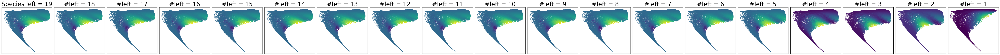

In [21]:
path_metadata = "metadata/"
filename_species_names = "Xu-state-space-names.csv"
path_data = "data-files/"

save = True
pathSave = f"C:/Users/Admin/Documents/Parente/Figures/2024-PV-optimization/Paper/Results/Simplification of the PV/Manifolds/"
name = f"f-PV manifolds - 35a_s3 - different sparsifications.png"


filename = f"Xu-AE-opt_RMSprop-epo_100000-lr_0.025-date_28Jan2025-hour_17h43_Tr35a_s3"
filename_metadata = filename + "_metadata.pkl"
loader = loadData(filename_species_names, path_metadata, filename_metadata)
idx_species_removed = loader.metadata["idx species removed"]
model = loader.loadModel()
id_model = loader.metadata["Training_id"]
output_idx = loader.metadata["output species idx"]
idx_species_removed = loader.metadata["idx species removed"]
input_scaling = loader.metadata["input scaling"]
input_species_scaling = loader.metadata["input species scaling"]
input_species_bias = loader.metadata["input species bias"]
range_mf  = loader.metadata["range_mf"]


rows, cols = 1, nbr_input_species
fig, axes = plt.subplots(rows, cols, figsize=(70, 4))  # Define the grid
axes = axes.flatten()

for i in range(nbr_input_species): #nbr_input_species):

    ax = axes[i]

    #Update the model with the threshold

    final_weights = copy.deepcopy(model.encoder_species.weight.detach().numpy()[0])

    if(model.auto_scaling):
        final_weights *= model.scaling_weights.detach().numpy()

    #get index spcies removed
    my_species = Species(path_data)
    
    list_species = my_species.get_list_species()
    for index in sorted(idx_species_removed, reverse=True):
        list_species.pop(index)

    #get mass fractions of species
    state_space = read_csv(path_state, header = None)
    state_space = state_space.drop(state_space.columns[idx_species_removed], axis=1)
    state_space_matrix = state_space.to_numpy()

    wi_Yi = state_space_matrix*np.abs(final_weights) #|w_i|*Y_i
    max_wi_Yi = np.max(wi_Yi, axis = 0) #take max of every species

    #selection of values greater than zero
    #CHECK that none of the weights in the PV is already zero!
    mask = max_wi_Yi > 0

    #Find the index with the minimum max wi Yi which is not zero
    index_species_min_max_wi_Yi = np.argmin(max_wi_Yi[mask])

    #Get the index back in the original array
    index_species_min_max_wi_Yi = np.where(mask)[0][index_species_min_max_wi_Yi]
    
    if(i>0): #do not simplify for the first iteration to have the first value with all input species
        with torch.no_grad():
            model.encoder_species.weight[0,index_species_min_max_wi_Yi] = 0
            order_species_removed.append(list_input_species[index_species_min_max_wi_Yi])

    optimized_PV = model.get_PV(torch.from_numpy(np.delete(data_state_space, idx_species_removed, axis=1))).detach().numpy()
    optimized_PV_source = model.get_PV(torch.from_numpy(np.delete(data_state_space_source, idx_species_removed, axis=1))).detach().numpy()
    
    random_idx = np.random.choice(len(optimized_PV), size=10000, replace=False)

    #ax.scatter(data_mf[random_idx], optimized_PV[random_idx], c = optimized_PV_source[random_idx], cmap = "viridis", s=1)

    ax.scatter(data_mf, optimized_PV, c = optimized_PV_source, cmap = "viridis", s=1)

    #ax.set_xlabel("f [\u2014]", fontsize = 20)
    ax.set_xticks([])
    #if(i%cols == 0):
        #ax.set_ylabel(f'Optimized PV [\u2014]', fontsize = 20)
    ax.set_yticks([])
    if(i==0):
         ax.set_title(f"Species left = {19-i}", fontsize=30)
    else:
         ax.set_title(f"#left = {19-i}", fontsize=30)


plt.tight_layout()
if(save):
        plt.savefig(f"{pathSave}{name}", dpi = 300, bbox_inches="tight")
plt.show()

C:\Windows\Temp\ipykernel_8880\947260983.py:108: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


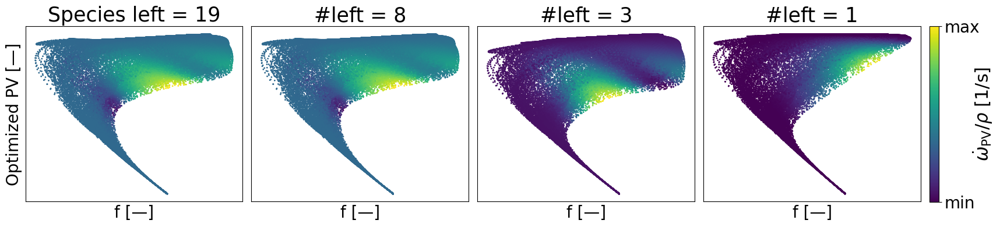

In [40]:
path_metadata = "metadata/"
filename_species_names = "Xu-state-space-names.csv"
path_data = "data-files/"

path_state = path_data + "Xu-state-space-low.csv"

save = True
pathSave = f"C:/Users/Admin/Documents/Parente/Figures/2024-PV-optimization/Paper/Results/Simplification of the PV/Manifolds/"
name = f"f-PV manifolds - 35a_s3 - different sparsifications - PAPER - v2.png"
namePDF = f"f-PV manifolds - 35a_s3 - different sparsifications - PAPER - v2.pdf"

filename = f"Xu-AE-opt_RMSprop-epo_100000-lr_0.025-date_28Jan2025-hour_17h43_Tr35a_s3"
filename_metadata = filename + "_metadata.pkl"
loader = loadData(filename_species_names, path_metadata, filename_metadata)
idx_species_removed = loader.metadata["idx species removed"]
model = loader.loadModel()
id_model = loader.metadata["Training_id"]
output_idx = loader.metadata["output species idx"]
idx_species_removed = loader.metadata["idx species removed"]
input_scaling = loader.metadata["input scaling"]
input_species_scaling = loader.metadata["input species scaling"]
input_species_bias = loader.metadata["input species bias"]
range_mf  = loader.metadata["range_mf"]

species_left = [19, 8, 3, 1]

rows, cols = 1, len(species_left)
fig, axes = plt.subplots(rows, cols, figsize=(16, 4))  # Define the grid
axes = axes.flatten()


idx_axis = 0

for i in range(nbr_input_species): #nbr_input_species):


    #Update the model with the threshold

    final_weights = copy.deepcopy(model.encoder_species.weight.detach().numpy()[0])

    if(model.auto_scaling):
        final_weights *= model.scaling_weights.detach().numpy()

    #get index spcies removed
    my_species = Species(path_data)
    
    list_species = my_species.get_list_species()
    for index in sorted(idx_species_removed, reverse=True):
        list_species.pop(index)

    #get mass fractions of species
    state_space = read_csv(path_state, header = None)
    state_space = state_space.drop(state_space.columns[idx_species_removed], axis=1)
    state_space_matrix = state_space.to_numpy()

    wi_Yi = state_space_matrix*np.abs(final_weights) #|w_i|*Y_i
    max_wi_Yi = np.max(wi_Yi, axis = 0) #take max of every species

    #selection of values greater than zero
    #CHECK that none of the weights in the PV is already zero!
    mask = max_wi_Yi > 0

    #Find the index with the minimum max wi Yi which is not zero
    index_species_min_max_wi_Yi = np.argmin(max_wi_Yi[mask])

    #Get the index back in the original array
    index_species_min_max_wi_Yi = np.where(mask)[0][index_species_min_max_wi_Yi]
    
    if(i>0): #do not simplify for the first iteration to have the first value with all input species
        with torch.no_grad():
            model.encoder_species.weight[0,index_species_min_max_wi_Yi] = 0
            order_species_removed.append(list_input_species[index_species_min_max_wi_Yi])

    optimized_PV = model.get_PV(torch.from_numpy(np.delete(data_state_space, idx_species_removed, axis=1))).detach().numpy()
    optimized_PV_source = model.get_PV(torch.from_numpy(np.delete(data_state_space_source, idx_species_removed, axis=1))).detach().numpy()
    
    random_idx = np.random.choice(len(optimized_PV), size=10000, replace=False)

    if(nbr_input_species-i in species_left):
        ax = axes[idx_axis]
        #ax.scatter(data_mf[random_idx], optimized_PV[random_idx], c = optimized_PV_source[random_idx], cmap = "viridis", s=1)

        sc = ax.scatter(data_mf, optimized_PV, c=optimized_PV_source, cmap="viridis", s=1)

        ax.set_xlabel("f [\u2014]", fontsize = 20)
        ax.set_xticks([])
        if(i == 0):
            ax.set_ylabel(f'Optimized PV [\u2014]', fontsize = 20)
        ax.set_yticks([])
        if(idx_axis==0):
            ax.set_title(f"Species left = {19-i}", fontsize=25)
        else:
            ax.set_title(f"#left = {19-i}", fontsize=25)
        if(i==18):
            cax = fig.add_axes([1, 0.12, 0.01, 0.755])
            cbar = fig.colorbar(sc, cax=cax, orientation='vertical')
            cbar.set_label(r'$\dot{\omega}_{\mathrm{PV}} / \rho$ [1/s]', fontsize=22, labelpad = -10)

            vmin = optimized_PV_source.min()
            vmax = optimized_PV_source.max()
            cbar.set_ticks([vmin, vmax])
            cbar.set_ticklabels([f"min", f"max"])
            cbar.ax.tick_params(labelsize=20)

        idx_axis += 1


plt.tight_layout()
if(save):
        plt.savefig(f"{pathSave}{name}", dpi = 1000, bbox_inches="tight")
        #plt.savefig(f"{pathSave}{namePDF}", bbox_inches="tight")
plt.show()

***
<h2> Flamelet case

In [9]:
path_state = path_data + "Xu-state-space-flamelet.csv"

cost_array = []
MSE_kr_array = []
order_species_removed_fl = []
model = loader.loadModel()

compute_cost = False
compute_Kreg = False

nbr_observations = 10
sample_dataset = True

for i in range(nbr_input_species): #nbr_input_species):

    #Update the model with the threshold

    final_weights = copy.deepcopy(model.encoder_species.weight.detach().numpy()[0])

    if(model.auto_scaling):
        final_weights *= model.scaling_weights.detach().numpy()

    #get index spcies removed
    my_species = Species(path_data)
    
    list_species = my_species.get_list_species()
    for index in sorted(idx_species_removed, reverse=True):
        list_species.pop(index)

    #get mass fractions of species
    state_space = read_csv(path_state, header = "infer")
    state_space = state_space.drop(state_space.columns[idx_species_removed], axis=1)
    state_space_matrix = state_space.to_numpy()

    wi_Yi = state_space_matrix*np.abs(final_weights) #|w_i|*Y_i
    max_wi_Yi = np.max(wi_Yi, axis = 0) #take max of every species

    #selection of values greater than zero
    #CHECK that none of the weights in the PV is already zero!
    mask = max_wi_Yi > 0

    #Find the index with the minimum max wi Yi which is not zero
    index_species_min_max_wi_Yi = np.argmin(max_wi_Yi[mask])

    #Get the index back in the original array
    index_species_min_max_wi_Yi = np.where(mask)[0][index_species_min_max_wi_Yi]
    
    if(i>0): #do not simplify for the first iteration to have the first value with all input species
        with torch.no_grad():
            model.encoder_species.weight[0,index_species_min_max_wi_Yi] = 0
            order_species_removed_fl.append(list_input_species[index_species_min_max_wi_Yi])


    ##########################
    #Compute the manifold cost
    ##########################
    
    #get the input (PV and f) and the output (interested Yi, T and source terms) data
    input, output = get_dataset(path_data + "Xu-state-space-flamelet.csv", path_data + "Xu-state-space_source-flamelet.csv", path_data + "Xu-T-flamelet.csv",
                                path_data + "Xu-mf-flamelet.csv", output_idx, idx_species_removed, input_scaling, input_species_scaling, input_species_bias, range_mf)
    
    if(sample_dataset):
        #sample to speed up the tests
        torch.manual_seed(my_seed)
        indices = torch.randint(0, input.size(0), (nbr_observations,)) #set here the number of observations sampled, previous version was with 10k observations (?)
        input = input[indices]
        output = output[indices]
    

    PV = model.get_PV(input)
    PV_f = torch.cat((PV, input[:, -1].reshape(-1, 1)), dim = 1) #reshape to be (5200,1) instead of (52000)
    output = model.get_source_PV(output, input_species_scaling)

    #scale every column of the PV_f tensor between 0 and 1
    min_vals = PV_f.min(dim=0, keepdim=True).values
    max_vals = PV_f.max(dim=0, keepdim=True).values
    PV_f_scaled = (PV_f - min_vals) / (max_vals - min_vals)

    indepVars = PV_f_scaled.detach().numpy()
    depVars = output.detach().numpy()
    
    if(compute_cost):
        #Compute the cost
        variance_data = compute_normalized_variance(indepVars,
                                                    depVars,
                                                    depvar_names=depvar_names,
                                                    bandwidth_values=bandwidth_values)
        costs = cost_function_normalized_variance_derivative(variance_data,
                                                            penalty_function=penalty_function,
                                                            power=power,
                                                            vertical_shift=vertical_shift,
                                                            norm=None)
        print(f"{np.round(compute_avg(np.array(costs)),3)}")
        cost_array.append(compute_avg(np.array(costs)))
    

    #####################
    #Compute the Kreg MSE
    #####################

    mse_values_model = np.zeros(len(neighbours))

    min_output = output.min(dim=0, keepdim=True)[0]  # Minimum values for each column
    max_output = output.max(dim=0, keepdim=True)[0]  # Maximum values for each column

    output_scaled = (output - min_output) / (max_output - min_output)

    #create training and validation datasets
    np.random.seed(my_seed)
    nbr_observations = PV_f_scaled.shape[0]
    indices = np.arange(nbr_observations)
    nbr_train = int(nbr_observations*0.8)
    # Sample 40,000 unique indices
    sampled_indices = np.random.choice(indices, size=nbr_train, replace=False)
    validation_indices = np.setdiff1d(indices, sampled_indices)

    input_model = PV_f_scaled.detach().numpy()
    output_model = output_scaled.detach().numpy()

    if(compute_Kreg):
        for j, neighbour in enumerate(neighbours):

            query = input_model[validation_indices,:]

            kernel_model = KReg(input_model[sampled_indices, :], output_model[sampled_indices, :])
            predicted_model = kernel_model.predict(query, 'nearest_neighbors_isotropic', n_neighbors=neighbour)

            squared_error_model = (predicted_model - output_model[validation_indices,:]) ** 2
            mse_model = np.mean(squared_error_model)
            mse_values_model[j] = mse_model

        avg_mse = np.mean(mse_values_model)
        std_mse = np.std(mse_values_model)

        print(f"{round(avg_mse*10000,3)} (\u00B1 {round(std_mse*10000, 3)})")

        MSE_kr_array.append(avg_mse)

#add the last species into the list of removed species
tensor = model.encoder_species.weight[0, :]
non_zero_indices = torch.nonzero(tensor, as_tuple=True)
print(f"non zero indices in tuple {non_zero_indices}")
non_zero_indices_list = non_zero_indices[0].tolist()
print(f"last element to add {non_zero_indices_list}")
order_species_removed_fl.append(list_input_species[non_zero_indices_list[0]])

non zero indices in tuple (tensor([3]),)
last element to add [3]


In [22]:
MSE_kr_array_pow4_flamelet = np.load("paper/data/MSE_list_Tr35a_s3_low_PV_simplification_flamelet.npy")
MSEPV_kr_array_pow4_flamelet = np.load("paper/data/MSEPV_list_Tr35a_s3_low_PV_simplification_flamelet.npy")

MSE_kr_bw_array_flamelet = np.load("paper/data/MSE_list_Tr35a_s3_flamelet_PV_simplification_Kreg_bw001.npy")
MSEPV_kr_bw_array_flamelet = np.load("paper/data/MSEPV_list_Tr35a_s3_flamelet_PV_simplification_Kreg_bw001.npy")

MSE_kr_bw0001_array_flamelet = np.load("paper/data/MSE_list_Tr35a_s3_flamelet_PV_simplification_Kreg_bw0001.npy")
MSEPV_kr_bw0001_array_flamelet = np.load("paper/data/MSEPV_list_Tr35a_s3_flamelet_PV_simplification_Kreg_bw0001.npy")

MSE_NN_array_flamelet = np.load("data-files/MSE_NN/MSE_val_NN_Tr35a_flamelet_PV_simplification.npy")
MSE_NN_PV_array_flamelet = np.load("data-files/MSE_NN/MSE_PVsource_val_NN_Tr35a_flamelet_PV_simplification.npy")


cost_array_pow4_flamelet = np.load("paper/data/cost_list_Tr35a_s3_low_PV_simplification_pow4_flamelet.npy")
costPV_array_pow4_flamelet = np.load("paper/data/costPV_list_Tr35a_s3_low_PV_simplification_pow4_flamelet.npy")

## Manifolds for different species when sparsifying

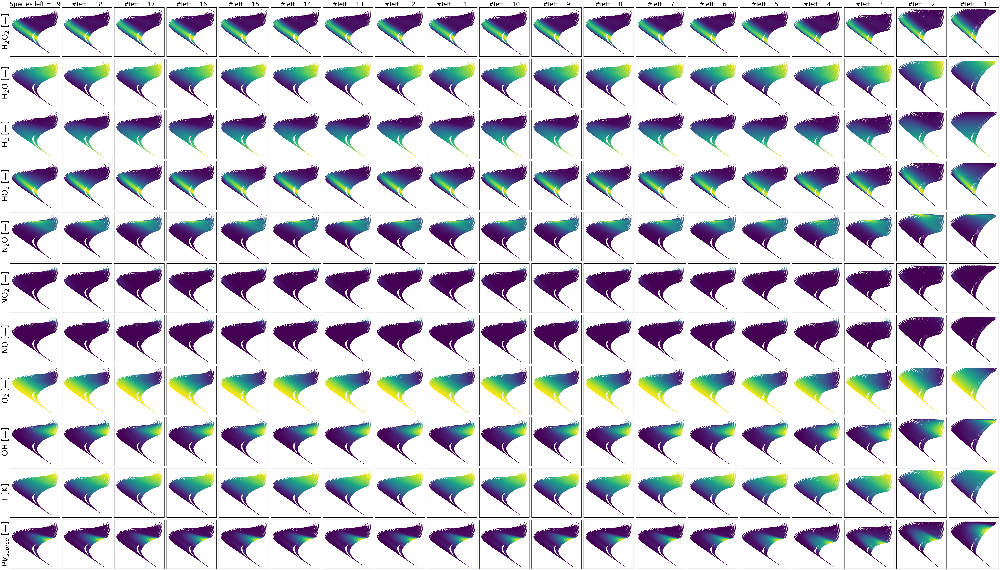

In [ ]:
path_metadata = "metadata/"
filename_species_names = "Xu-state-space-names.csv"
path_data = "data-files/"
path_state = path_data + "Xu-state-space-flamelet.csv"

save = True
pathSave = f"C:/Users/Admin/Documents/Parente/Figures/2024-PV-optimization/Paper/Results/Simplification of the PV/Manifolds/"
name = f"f-PV manifolds - 35a_s3 - different sparsifications - all species - Flamelet.png"

keys = ['H2O2', 'H2O', 'H2', 'HO2', 'N2O', 'NO2', 'NO', 'O2', 'OH', 'T', 'PV1']


filename = f"Xu-AE-opt_RMSprop-epo_100000-lr_0.025-date_28Jan2025-hour_17h43_Tr35a_s3"
filename_metadata = filename + "_metadata.pkl"
loader = loadData(filename_species_names, path_metadata, filename_metadata)
idx_species_removed = loader.metadata["idx species removed"]
model = loader.loadModel()
id_model = loader.metadata["Training_id"]
output_idx = loader.metadata["output species idx"]
idx_species_removed = loader.metadata["idx species removed"]
input_scaling = loader.metadata["input scaling"]
input_species_scaling = loader.metadata["input species scaling"]
input_species_bias = loader.metadata["input species bias"]
range_mf  = loader.metadata["range_mf"]


rows, cols = len(keys), nbr_input_species
fig, axes = plt.subplots(rows, cols, figsize=(70, 40))  # Define the grid
axes = axes.flatten()

speciesToVisualize = [""]



for i in range(nbr_input_species): #nbr_input_species):

    #Update the model with the threshold

    final_weights = copy.deepcopy(model.encoder_species.weight.detach().numpy()[0])

    if(model.auto_scaling):
        final_weights *= model.scaling_weights.detach().numpy()

    #get index spcies removed
    my_species = Species(path_data)
    
    list_species = my_species.get_list_species()
    for index in sorted(idx_species_removed, reverse=True):
        list_species.pop(index)

    #get mass fractions of species
    state_space = read_csv(path_state, header = "infer")
    state_space = state_space.drop(state_space.columns[idx_species_removed], axis=1)
    state_space_matrix = state_space.to_numpy()

    wi_Yi = state_space_matrix*np.abs(final_weights) #|w_i|*Y_i
    max_wi_Yi = np.max(wi_Yi, axis = 0) #take max of every species

    #selection of values greater than zero
    #CHECK that none of the weights in the PV is already zero!
    mask = max_wi_Yi > 0

    #Find the index with the minimum max wi Yi which is not zero
    index_species_min_max_wi_Yi = np.argmin(max_wi_Yi[mask])

    #Get the index back in the original array
    index_species_min_max_wi_Yi = np.where(mask)[0][index_species_min_max_wi_Yi]
    
    if(i>0): #do not simplify for the first iteration to have the first value with all input species
        with torch.no_grad():
            model.encoder_species.weight[0,index_species_min_max_wi_Yi] = 0
            order_species_removed.append(list_input_species[index_species_min_max_wi_Yi])

    dataset = "flamelet"
    input_fl, output_fl = get_dataset(path_data + f"Xu-state-space-{dataset}.csv", path_data + f"Xu-state-space_source-{dataset}.csv",
                                    path_data + f"Xu-T-{dataset}.csv", path_data + f"Xu-mf-{dataset}.csv", output_idx,
                                    idx_species_removed, input_scaling, input_species_scaling, input_species_bias, range_mf)
    mf_fl, PV_fl, PV_source_fl = model.get_mf_PV_PVsource(input_fl, output_fl)

    data_state_space_fl = pd.read_csv(path_data + f"Xu-state-space-{dataset}.csv")
    data_T_fl = pd.read_csv(path_data + f"Xu-T-{dataset}.csv")


    for j, key in enumerate(keys):
        ax = axes[j*nbr_input_species + i]

        

        if(key == "PV1"):
            colorSpecies = PV_source_fl
            colorName = "$PV_{source}$ [\u2014]"
        elif(key == "T"):
            colorSpecies = data_T_fl["T"]
            colorName = "T [K]"
        else:
            colorSpecies = data_state_space_fl[key]
            colorName = f"{key.replace('2', '$_2$')} [\u2014]"
        
        #random_idx = np.random.choice(len(optimized_PV), size=10000, replace=False)
        #ax.scatter(data_mf[random_idx], optimized_PV[random_idx], c = colorSpecies[random_idx], cmap = "viridis", s=1)

        ax.scatter(mf_fl, PV_fl, c = colorSpecies, cmap = "viridis", s=1)

        #ax.set_xlabel("f [\u2014]", fontsize = 20)
        ax.set_xticks([])
        if(i == 0):
            ax.set_ylabel(colorName, fontsize = 40)
        ax.set_yticks([])
        if(i==0 and j==0):
            ax.set_title(f"Species left = {19-i}", fontsize=30)
        elif(j == 0):
            ax.set_title(f"#left = {19-i}", fontsize=30)


plt.tight_layout()
if(save):
        plt.savefig(f"{pathSave}{name}", dpi = 300, bbox_inches="tight")
plt.show()

***
<h2> Show manifolds with sparsified PV

Show the f-PV manifold with simplified PV

In [12]:
from os import listdir
from os.path import isfile, join
import numpy as np
from scipy.io import loadmat
from tools import *
import matplotlib.pyplot as plt
from loader import *
import logging

logging.disable(logging.CRITICAL) #disable the logging

In [13]:
data_path = 'data-files/'
nbr_species = 21
nbr_rows = 1536
nbr_cols = 1024

layer = 10 #chose layer to inspect

my_seed = 7

nbr_datapoints = 100000

In [ ]:
files = [i for i in listdir(data_path) if isfile(join(data_path + i))]
print(f"Number of files: {len(files)}")

Number of files: 89


In [ ]:
state_space_names = []
state_space_source_names = [] #to check it is the same order as the state space
Not_species = ["T","U","V","W","X","Z"]
state_space = np.zeros((1,nbr_species))
data_state_space = np.zeros((nbr_rows*nbr_cols,nbr_species))
data_state_space_source = np.zeros((nbr_rows*nbr_cols,nbr_species))
data_mf = np.zeros((nbr_rows*nbr_cols,1))
data_T = np.zeros((nbr_rows*nbr_cols,1))

counter_state_space = 0
counter_state_space_source = 0

for file in files:
    if file.endswith('.mat'):
        print(f"Busy with {file}")

        data = loadmat(data_path + file)

        filename = file.removesuffix('.mat')
        file_data = np.array(data[filename])
        

        #if name of the file is not starting with an uppercase
        if(not file[0] == "R" and file[0].isupper() and file[0] not in Not_species):
            state_space_names.append(file.removesuffix('_3D_slice.mat'))
            flattened_data = file_data[layer, 0][0, :, :].flatten()
            data_state_space[:,counter_state_space] = flattened_data

            counter_state_space+=1

        elif(file[0] == "R"):
            state_space_source_names.append(file.removesuffix('_3D_slice.mat'))
            flattened_data = file_data[layer, 0][0, :, :].flatten()
            data_state_space_source[:,counter_state_space_source] = flattened_data

            counter_state_space_source+=1

        elif(file[0] == "Z"):

            flattened_data = file_data[layer, 0][0, :, :].flatten()
            data_mf[:,0] = flattened_data
            
            print()
            print("mass fraction data done")
            print()

        elif(file[0] == "T"):

            flattened_data = file_data[layer, 0][0, :, :].flatten()
            data_T[:,0] = flattened_data
            
            print()
            print("Temperature data done")
            print()

print(state_space_names)
print(f"counters of state space and sources are {counter_state_space} and {counter_state_space_source}")

Busy with curvature_Condi_3D_slices.mat
Busy with H2NN_3D_slice.mat
Busy with H2O2_3D_slice.mat
Busy with H2O_3D_slice.mat
Busy with H2_3D_slice.mat
Busy with HNO_3D_slice.mat
Busy with HO2_3D_slice.mat
Busy with HONO2_3D_slice.mat
Busy with HONO_3D_slice.mat
Busy with H_3D_slice.mat
Busy with N2H3_3D_slice.mat
Busy with N2O_3D_slice.mat
Busy with N2_3D_slice.mat
Busy with NH2_3D_slice.mat
Busy with NH_3D_slice.mat
Busy with NNH_3D_slice.mat
Busy with NO2_3D_slice.mat
Busy with NO_3D_slice.mat
Busy with N_3D_slice.mat
Busy with O2_3D_slice.mat
Busy with OH_3D_slice.mat
Busy with O_3D_slice.mat
Busy with RH2NN_3D_slice.mat
Busy with RH2O2_3D_slice.mat
Busy with RH2O_3D_slice.mat
Busy with RH2_3D_slice.mat
Busy with RHNO_3D_slice.mat
Busy with RHO2_3D_slice.mat
Busy with RHONO2_3D_slice.mat
Busy with RHONO_3D_slice.mat
Busy with RH_3D_slice.mat
Busy with RN2H3_3D_slice.mat
Busy with RN2O_3D_slice.mat
Busy with RN2_3D_slice.mat
Busy with RNH2_3D_slice.mat
Busy with RNH_3D_slice.mat
Busy w

***
<h2> Autoignition case

In [ ]:
path_state = path_data + "Xu-state-space-autoignition.csv"

filename_model = "Xu-AE-opt_adam-epo_100000-lr_0.025-date_14Mar2025-hour_14h23_Tr0D-2q_s0"
filename_metadata_0D = filename_model + "_metadata.pkl"

loader_0D = loadData(filename_species_names, path_metadata, filename_metadata_0D)
output_idx = loader_0D.metadata["list idx species removed source"] if loader_0D.metadata["dataset_type"].startswith("autoignition_augm") else loader_0D.metadata["idx species removed"]
idx_species_removed = loader_0D.metadata["list idx species removed source"] if loader_0D.metadata["dataset_type"].startswith("autoignition_augm") else loader_0D.metadata["idx species removed"]
input_scaling = loader_0D.metadata["input scaling"]
input_species_scaling = loader_0D.metadata["input species scaling"]
input_species_bias = loader_0D.metadata["input species bias"]
range_mf  = loader_0D.metadata["range_mf"]
depvar_names_species = loader_0D.metadata["list species output"]
depvar_names_idx = loader_0D.metadata["output elements"]
PV_dim = loader_0D.metadata["PV dim"]
depvar_names = depvar_names_species + depvar_names_idx[-(PV_dim+1):]
model_0D = loader_0D.loadModel()
id = loader_0D.metadata["Training_id"]
nbr_input_species = loader_0D.metadata["nbr input species"]


cost_array = []
MSE_kr_array = []
order_species_removed_0D = []

compute_cost = False
compute_Kreg = False

nbr_observations = 10
sample_dataset = True

for i in range(nbr_input_species): #nbr_input_species):

    #Update the model with the threshold

    final_weights = model_0D.get_total_encoder_weights(npy = True)[0]

    #get index spcies removed
    my_species = Species(path_data)
    
    list_species = my_species.get_list_species()
    for index in sorted(idx_species_removed, reverse=True):
        list_species.pop(index)

    #get mass fractions of species
    state_space = read_csv(path_state, header = "infer")
    state_space = state_space.drop(state_space.columns[idx_species_removed], axis=1)
    state_space_matrix = state_space.to_numpy()

    wi_Yi = state_space_matrix*np.abs(final_weights) #|w_i|*Y_i
    max_wi_Yi = np.max(wi_Yi, axis = 0) #take max of every species

    #selection of values greater than zero
    #CHECK that none of the weights in the PV is already zero!
    mask = max_wi_Yi > 0

    #Find the index with the minimum max wi Yi which is not zero
    index_species_min_max_wi_Yi = np.argmin(max_wi_Yi[mask])

    #Get the index back in the original array
    index_species_min_max_wi_Yi = np.where(mask)[0][index_species_min_max_wi_Yi]
    
    if(i>0): #do not simplify for the first iteration to have the first value with all input species
        with torch.no_grad():
            model_0D.encoder_species.weight[0,index_species_min_max_wi_Yi] = 0
            order_species_removed_0D.append(list_input_species[index_species_min_max_wi_Yi])


    ##########################
    #Compute the manifold cost
    ##########################
    
    #get the input (PV and f) and the output (interested Yi, T and source terms) data
    input, output = get_dataset(path_data + "Xu-state-space-autoignition.csv", path_data + "Xu-state-space_source-autoignition.csv", path_data + "Xu-T-autoignition.csv",
                                path_data + "Xu-mf-autoignition.csv", output_idx, idx_species_removed, input_scaling, input_species_scaling, input_species_bias, range_mf)
    
    if(sample_dataset):
        #sample to speed up the tests
        torch.manual_seed(my_seed)
        indices = torch.randint(0, input.size(0), (nbr_observations,)) #set here the number of observations sampled, previous version was with 10k observations (?)
        input = input[indices]
        output = output[indices]
    

    PV = model_0D.get_PV(input)
    PV_f = torch.cat((PV, input[:, -1].reshape(-1, 1)), dim = 1) #reshape to be (5200,1) instead of (52000)
    output = model_0D.get_source_PV(output, input_species_scaling)

    #scale every column of the PV_f tensor between 0 and 1
    min_vals = PV_f.min(dim=0, keepdim=True).values
    max_vals = PV_f.max(dim=0, keepdim=True).values
    PV_f_scaled = (PV_f - min_vals) / (max_vals - min_vals)

    indepVars = PV_f_scaled.detach().numpy()
    depVars = output.detach().numpy()
    
    if(compute_cost):
        #Compute the cost
        variance_data = compute_normalized_variance(indepVars,
                                                    depVars,
                                                    depvar_names=depvar_names,
                                                    bandwidth_values=bandwidth_values)
        costs = cost_function_normalized_variance_derivative(variance_data,
                                                            penalty_function=penalty_function,
                                                            power=power,
                                                            vertical_shift=vertical_shift,
                                                            norm=None)
        print(f"{np.round(compute_avg(np.array(costs)),3)}")
        cost_array.append(compute_avg(np.array(costs)))
    

    #####################
    #Compute the Kreg MSE
    #####################

    mse_values_model = np.zeros(len(neighbours))

    min_output = output.min(dim=0, keepdim=True)[0]  # Minimum values for each column
    max_output = output.max(dim=0, keepdim=True)[0]  # Maximum values for each column

    output_scaled = (output - min_output) / (max_output - min_output)

    #create training and validation datasets
    np.random.seed(my_seed)
    nbr_observations = PV_f_scaled.shape[0]
    indices = np.arange(nbr_observations)
    nbr_train = int(nbr_observations*0.8)
    # Sample 40,000 unique indices
    sampled_indices = np.random.choice(indices, size=nbr_train, replace=False)
    validation_indices = np.setdiff1d(indices, sampled_indices)

    input_model = PV_f_scaled.detach().numpy()
    output_model = output_scaled.detach().numpy()

    if(compute_Kreg):
        for j, neighbour in enumerate(neighbours):

            query = input_model[validation_indices,:]

            kernel_model = KReg(input_model[sampled_indices, :], output_model[sampled_indices, :])
            predicted_model = kernel_model.predict(query, 'nearest_neighbors_isotropic', n_neighbors=neighbour)

            squared_error_model = (predicted_model - output_model[validation_indices,:]) ** 2
            mse_model = np.mean(squared_error_model)
            mse_values_model[j] = mse_model

        avg_mse = np.mean(mse_values_model)
        std_mse = np.std(mse_values_model)

        print(f"{round(avg_mse*10000,3)} (\u00B1 {round(std_mse*10000, 3)})")

        MSE_kr_array.append(avg_mse)

#add the last species into the list of removed species
tensor = model_0D.encoder_species.weight[0, :]
non_zero_indices = torch.nonzero(tensor, as_tuple=True)
print(f"non zero indices in tuple {non_zero_indices}")
non_zero_indices_list = non_zero_indices[0].tolist()
print(f"last element to add {non_zero_indices_list}")
order_species_removed_0D.append(list_input_species[non_zero_indices_list[0]])

non zero indices in tuple (tensor([2]),)
last element to add [2]


In [23]:
MSE_kr_array_pow4_autoignition = np.load("paper/data/MSE_list_Tr0D-2q_s0_low_PV_simplification_autoignition.npy")
MSEPV_kr_array_pow4_autoignition = np.load("paper/data/MSEPV_list_Tr0D-2q_s0_low_PV_simplification_autoignition.npy")

MSE_kr_bw_array_autoignition = np.load("paper/data/MSE_list_Tr0D-2q_s0_autoignition_PV_simplification_Kreg_bw001.npy")
MSEPV_kr_bw_array_autoignition = np.load("paper/data/MSEPV_list_Tr0D-2q_s0_autoignition_PV_simplification_Kreg_bw001.npy")

MSE_kr_bw0001_array_autoignition = np.load("paper/data/MSE_list_Tr0D-2q_s0_autoignition_PV_simplification_Kreg_bw0001.npy")
MSEPV_kr_bw0001_array_autoignition = np.load("paper/data/MSEPV_list_Tr0D-2q_s0_autoignition_PV_simplification_Kreg_bw0001.npy")

MSE_NN_array_autoignition = np.load("data-files/MSE_NN/MSE_val_NN_Tr0D-2q_autoignition_PV_simplification.npy")
MSE_NN_PV_array_autoignition = np.load("data-files/MSE_NN/MSE_PVsource_val_NN_Tr0D-2q_autoignition_PV_simplification.npy")

cost_array_pow4_autoignition = np.load("paper/data/cost_list_Tr0D-2q_s0_low_PV_simplification_pow4_autoignition.npy")
costPV_array_pow4_autoignition = np.load("paper/data/costPV_list_Tr0D-2q_s0_low_PV_simplification_pow4_autoignition.npy")

## With MSE NN values

### Manifolds 0D when sparsifying with different species

In [12]:
filename_autoignition = "isochoric-adiabatic-closed-HR-H2-air-lin_Z_0.015_0.035_100-T0_900-"
path_data_autoignition = "data-files/autoignition/"
path_data = "data-files/"

#create all the datasets
mixture_fractions_train_0D = np.loadtxt(f"{path_data_autoignition}{filename_autoignition}mixture-fraction.csv") #1 x nbr_timesteps
mixture_fractions_test_0D = np.loadtxt(f"{path_data_autoignition}{filename_autoignition}mixture-fractions-test-trajectories.csv") #1 x nbr_test_trajectories
state_space_names = np.genfromtxt(f"{path_data_autoignition}{filename_autoignition}state-space-names.csv", delimiter=",", dtype=str)
state_space_train_0D = pd.read_csv(f"{path_data_autoignition}{filename_autoignition}state-space.csv", names = state_space_names)
state_space_source_train_0D = pd.read_csv(f"{path_data_autoignition}{filename_autoignition}state-space-sources.csv", names = state_space_names)
time_train = np.loadtxt(f"{path_data_autoignition}{filename_autoignition}time.csv") #1 x nbr_timesteps

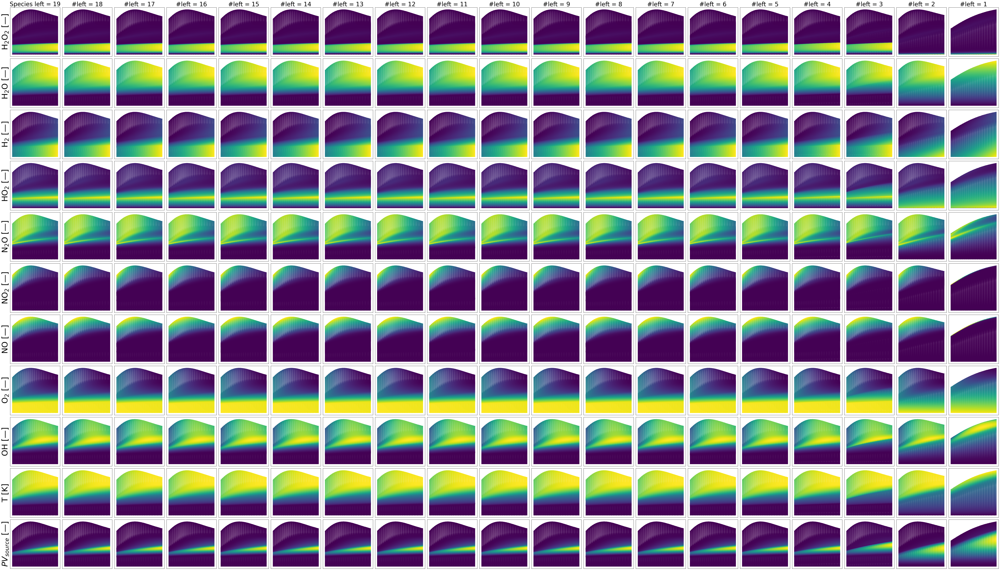

In [ ]:
path_metadata = "metadata/"
filename_species_names = "Xu-state-space-names.csv"
path_data = "data-files/"
path_state_0D = path_data + "Xu-state-space-autoignition.csv"

save = True
pathSave = f"C:/Users/Admin/Documents/Parente/Figures/2024-PV-optimization/Paper/Results/Simplification of the PV/Manifolds/"
name = f"f-PV manifolds - 2q_s0 - different sparsifications - all species - Autoignition -downscaled further.png"

keys = ['H2O2', 'H2O', 'H2', 'HO2', 'N2O', 'NO2', 'NO', 'O2', 'OH', 'T', 'PV1']

filename_model = "Xu-AE-opt_adam-epo_100000-lr_0.025-date_14Mar2025-hour_14h23_Tr0D-2q_s0"
filename_metadata = filename_model + "_metadata.pkl"
path_metadata = "metadata/"
filename_species_names = "Xu-state-space-names.csv"
path_data = "data-files/"

loader = loadData(filename_species_names, path_metadata, filename_metadata)
idx_species_removed = loader.metadata["list idx species removed source"] if loader.metadata["dataset_type"].startswith("autoignition_augm") else loader.metadata["idx species removed"]
id_model = loader.metadata["Training_id"]
model = loader.loadModel()
nbr_input_species = loader.metadata["nbr input species"]

weight_inversion = True
if(weight_inversion):
    with torch.no_grad():  # Ensures we do not track gradients for this operation
        model.encoder_species.weight.mul_(-1)


rows, cols = len(keys), nbr_input_species
fig, axes = plt.subplots(rows, cols, figsize=(70, 40))  # Define the grid
axes = axes.flatten()

speciesToVisualize = [""]

for idxSpecies in range(nbr_input_species): #nbr_input_species):

    #Update the model with the threshold

    final_weights = copy.deepcopy(model.encoder_species.weight.detach().numpy()[0])

    if(model.auto_scaling):
        final_weights *= model.scaling_weights.detach().numpy()

    #get index spcies removed
    my_species = Species(path_data)

    #get mass fractions of species
    state_space_0D = read_csv(path_state_0D, header = "infer")
    state_space_0D = state_space_0D.drop(state_space_0D.columns[idx_species_removed], axis=1)
    state_space_matrix = state_space_0D.to_numpy()

    wi_Yi = state_space_matrix*np.abs(final_weights) #|w_i|*Y_i
    max_wi_Yi = np.max(wi_Yi, axis = 0) #take max of every species

    #selection of values greater than zero
    #CHECK that none of the weights in the PV is already zero!
    mask = max_wi_Yi > 0

    #Find the index with the minimum max wi Yi which is not zero
    index_species_min_max_wi_Yi = np.argmin(max_wi_Yi[mask])

    #Get the index back in the original array
    index_species_min_max_wi_Yi = np.where(mask)[0][index_species_min_max_wi_Yi]

    
    if(idxSpecies>0): #do not simplify for the first iteration to have the first value with all input species
        with torch.no_grad():
            model.encoder_species.weight[0,index_species_min_max_wi_Yi] = 0
            order_species_removed.append(list_input_species[index_species_min_max_wi_Yi])

    dataset = "autoignition"
    state_space_names_DNS = np.genfromtxt(f"{path_data}Xu-state-space-names.csv", delimiter=",", dtype=str)
    state_space_train_DNS = state_space_train_0D[state_space_names_DNS].to_numpy()
    state_space_source_train_DNS = state_space_source_train_0D[state_space_names_DNS].to_numpy()
    PV_optimized_train_0D = model.get_PV(torch.from_numpy(np.delete(state_space_train_DNS, idx_species_removed, axis=1))).detach().numpy()
    PV_optimized_source_train_0D = model.get_PV(torch.from_numpy(np.delete(state_space_source_train_DNS, idx_species_removed, axis=1))).detach().numpy()

    for idxKey, key in enumerate(keys):
        ax = axes[idxKey*nbr_input_species + idxSpecies]

        if(key == "PV1"):
            colorSpecies = PV_optimized_source_train_0D
            colorName = "$PV_{source}$ [\u2014]"
        elif(key == "T"):
            colorSpecies = state_space_train_0D["T"]
            colorName = "T [K]"
        else:
            colorSpecies = state_space_train_0D[key]
            colorName = f"{key.replace('2', '$_2$')} [\u2014]"

        random_idx = np.random.choice(len(PV_optimized_train_0D), size=1000, replace=False)

        ax.scatter(mixture_fractions_train_0D, PV_optimized_train_0D, c = colorSpecies, cmap = "viridis", s=1)

        ax.set_xticks([])
        if(idxSpecies == 0):
            ax.set_ylabel(colorName, fontsize = 40)
        ax.set_yticks([])
        if(idxSpecies==0 and idxKey==0):
            ax.set_title(f"Species left = {19-idxSpecies}", fontsize=30)
        elif(idxKey == 0):
            ax.set_title(f"#left = {19-idxSpecies}", fontsize=30)


plt.tight_layout()
if(save):
        plt.savefig(f"{pathSave}{name}", dpi = 150, bbox_inches="tight")
plt.show()

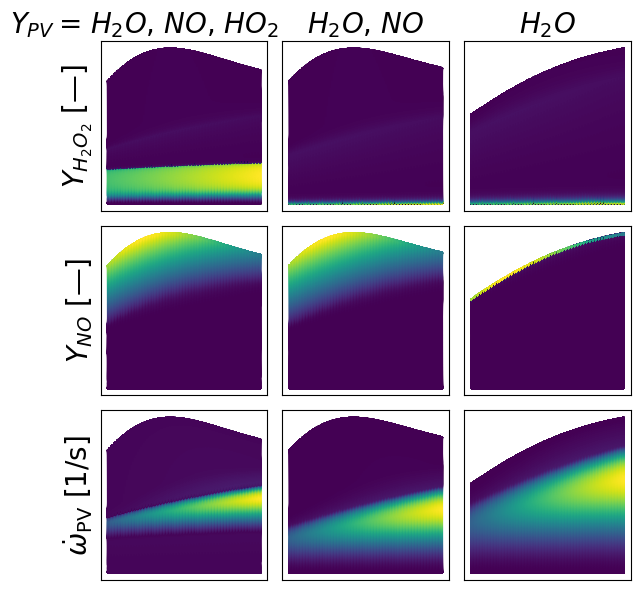

In [ ]:
path_metadata = "metadata/"
filename_species_names = "Xu-state-space-names.csv"
path_data = "data-files/"
path_state_0D = path_data + "Xu-state-space-autoignition.csv"

save = True
pathSave = f"C:/Users/Admin/Documents/Parente/Figures/2024-PV-optimization/Paper/Results/Simplification of the PV/Manifolds/"
name = f"f-PV manifolds - 2q_s0 - different sparsifications - H2O2, NO, PVsource - Autoignition - Paper.png"

keys = ['H2O2','NO', 'PV1']

nameCols = ["$H_2O$, $NO$, $HO_2$", "$H_2O$, $NO$", "$H_2O$"]

keysYaxis = [r"$Y_{H_2O_2}$"+ " [\u2014]", r"$Y_{NO}$"+ " [\u2014]", r"$\dot{\omega}_{\mathrm{PV}}$"+ " [1/s]"]

filename_model = "Xu-AE-opt_adam-epo_100000-lr_0.025-date_14Mar2025-hour_14h23_Tr0D-2q_s0"
filename_metadata = filename_model + "_metadata.pkl"
path_metadata = "metadata/"
filename_species_names = "Xu-state-space-names.csv"
path_data = "data-files/"

loader = loadData(filename_species_names, path_metadata, filename_metadata)
idx_species_removed = loader.metadata["list idx species removed source"] if loader.metadata["dataset_type"].startswith("autoignition_augm") else loader.metadata["idx species removed"]
id_model = loader.metadata["Training_id"]
model = loader.loadModel()
nbr_input_species = loader.metadata["nbr input species"]

weight_inversion = True
if(weight_inversion):
    with torch.no_grad():  # Ensures we do not track gradients for this operation
        model.encoder_species.weight.mul_(-1)


rows, cols = len(keys), 3
fig, axes = plt.subplots(rows, cols, figsize=(6, 6))  # Define the grid
axes = axes.flatten()

speciesToVisualize = [""]
idxAx = 0

for idxSpecies in range(nbr_input_species): #nbr_input_species):

    #Update the model with the threshold

    final_weights = copy.deepcopy(model.encoder_species.weight.detach().numpy()[0])

    if(model.auto_scaling):
        final_weights *= model.scaling_weights.detach().numpy()

    #get index spcies removed
    my_species = Species(path_data)

    #get mass fractions of species
    state_space_0D = read_csv(path_state_0D, header = "infer")
    state_space_0D = state_space_0D.drop(state_space_0D.columns[idx_species_removed], axis=1)
    state_space_matrix = state_space_0D.to_numpy()

    wi_Yi = state_space_matrix*np.abs(final_weights) #|w_i|*Y_i
    max_wi_Yi = np.max(wi_Yi, axis = 0) #take max of every species

    #selection of values greater than zero
    #CHECK that none of the weights in the PV is already zero!
    mask = max_wi_Yi > 0

    #Find the index with the minimum max wi Yi which is not zero
    index_species_min_max_wi_Yi = np.argmin(max_wi_Yi[mask])

    #Get the index back in the original array
    index_species_min_max_wi_Yi = np.where(mask)[0][index_species_min_max_wi_Yi]

    
    if(idxSpecies>0): #do not simplify for the first iteration to have the first value with all input species
        with torch.no_grad():
            model.encoder_species.weight[0,index_species_min_max_wi_Yi] = 0
            order_species_removed.append(list_input_species[index_species_min_max_wi_Yi])

    dataset = "autoignition"
    state_space_names_DNS = np.genfromtxt(f"{path_data}Xu-state-space-names.csv", delimiter=",", dtype=str)
    state_space_train_DNS = state_space_train_0D[state_space_names_DNS].to_numpy()
    state_space_source_train_DNS = state_space_source_train_0D[state_space_names_DNS].to_numpy()
    PV_optimized_train_0D = model.get_PV(torch.from_numpy(np.delete(state_space_train_DNS, idx_species_removed, axis=1))).detach().numpy()
    PV_optimized_source_train_0D = model.get_PV(torch.from_numpy(np.delete(state_space_source_train_DNS, idx_species_removed, axis=1))).detach().numpy()


    if(idxSpecies >= nbr_input_species - 3):

        for idxKey, key in enumerate(keys):
            ax = axes[idxAx + idxKey*3]

            if(key == "PV1"):
                colorSpecies = PV_optimized_source_train_0D
                colorName = "$PV_{source}$ [\u2014]"
            elif(key == "T"):
                colorSpecies = state_space_train_0D["T"]
                colorName = "T [K]"
            else:
                colorSpecies = state_space_train_0D[key]
                colorName = f"{key.replace('2', '$_2$')} [\u2014]"

            random_idx = np.random.choice(len(PV_optimized_train_0D), size=1000, replace=False)

            ax.scatter(mixture_fractions_train_0D, PV_optimized_train_0D, c = colorSpecies, cmap = "viridis", s=1)

            ax.set_xticks([])
            if(idxAx == 0):
                ax.set_ylabel(keysYaxis[idxKey], fontsize = 20)
            ax.set_yticks([])
            if(idxKey == 0):
                ax.set_title(f"{nameCols[idxAx]}", fontsize=20)

        idxAx += 1

fig.text(
    x=-0.06,                 # Horizontal position (close to the y-axis)
    y=0.95,                 # Vertical position (roughly same as column titles)
    s=r"$Y_{PV} =$",        # LaTeX math formatting
    ha="left", va="center", # Align left and vertically center
    fontsize=20
)

plt.tight_layout()
if(save):
        plt.savefig(f"{pathSave}{name}", dpi = 1000, bbox_inches="tight")
plt.show()

## Combine all three cases together

### With MSE kr values

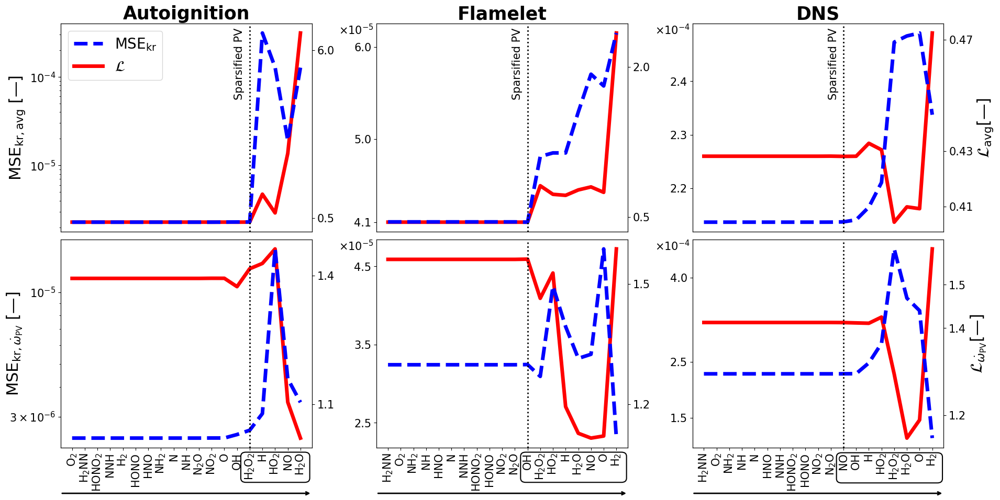

In [ ]:
save = True
clean = True
annotation = "with annotation"
pathSave = "C:/Users/admin/Documents/Parente/Figures/2024-PV-optimization/Paper/Results/Simplification of the PV/"
name = f"curves MSE kr - manifold cost threshold PV with PVsource comb - all datasets - with log.pdf"

fig, ax = plt.subplots(2, 3, figsize=(19.2, 9.6), sharex=False)

################################
# AUTOIGNITION (col 0)
################################
# Top plot
ax1 = ax[0,0]
x_axis_species = np.arange(nbr_input_species, 0, -1)
latex_species_list = [s.replace('2', r'$_2$') for s in order_species_removed_0D]
latex_species_list = [s.replace('3', r'$_3$') for s in latex_species_list]

ax1.plot(x_axis_species, MSE_kr_array_pow4_autoignition, 'b--', label="$\mathrm{MSE}_{\mathrm{kr}}$", linewidth=5)
ax1.set_ylabel('$\mathrm{MSE}_{\mathrm{kr, avg}}$ [\u2014]', fontsize=22)
ax1.tick_params(axis='y', labelsize=15)
if clean:
    ax1.tick_params(axis='x', labelsize=15)

if annotation == "with annotation":
    ax1.annotate("Sparsified PV", xy=(0.69, 0.98), xycoords='axes fraction',
                 fontsize=15, rotation=90, ha='left', va='top')

ax1.set_yscale("log")
ax1.get_yaxis().set_minor_formatter(ticker.NullFormatter())
ax1.yaxis.set_major_locator(LogLocator(numticks=2))

ax1.set_xticks(range(1, len(latex_species_list) + 1))
ax1.set_xticklabels(latex_species_list[::-1], rotation=90)
if annotation == "with annotation":
    ax1.axvline(x=5, color='k', linestyle=':', linewidth=2)

if clean:
    ax1.tick_params(axis='x', bottom=False, labelbottom=False)

# Second y-axis
ax2 = ax1.twinx()
ax2.plot(x_axis_species, cost_array_pow4_autoignition, 'r-', label=r'$\mathcal{L}$', linewidth=5)
ax2.tick_params(axis='y', labelsize=15)
ax2.set_yticks([0.5, 6])
ax1.set_zorder(ax2.get_zorder() + 1)
ax1.patch.set_visible(False)

ax1.invert_xaxis()

# Legend only here
lines_1, labels_1 = ax1.get_legend_handles_labels()
lines_2, labels_2 = ax2.get_legend_handles_labels()
ax1.legend(lines_1 + lines_2, labels_1 + labels_2, loc='upper left', fontsize=20)

# Bottom plot
ax3 = ax[1,0]
latex_species_list = [s.replace('2', r'$_2$') for s in order_species_removed_0D]
latex_species_list = [s.replace('3', r'$_3$') for s in latex_species_list]
ax3.plot(x_axis_species, MSEPV_kr_array_pow4_autoignition, 'b--', label="$\mathrm{MSE}_{NN}$", linewidth=5)
ax3.set_ylabel('$\mathrm{MSE}_{\mathrm{kr}, \dot{\omega}_{\mathrm{PV}}}$ [\u2014]', fontsize=22, labelpad = -20)
ax3.tick_params(axis='y', labelsize=15)
ax3.tick_params(axis='x', labelsize=15)
ax3.set_yscale("log")
ax3.get_yaxis().set_minor_formatter(ticker.NullFormatter())
# Explicit major ticks
ax3.set_yticks([3e-6, 1e-5])  

# Format them in scientific notation (normal font size)
def sci_notation(val, pos):
    if np.isclose(val, 3e-6):
        return r"$3\times 10^{-6}$"
    elif np.isclose(val, 1e-5):
        return r"$10^{-5}$"
    return ""

ax3.set_xticks(range(1, len(latex_species_list) + 1))
ax3.set_xticklabels(latex_species_list[::-1], rotation=90)

tick_positions = ax3.get_xticks()[17:]  # Select the first 8 ticks
tick_labels = ax3.get_xticklabels()[17:]

#box around the selected species for the simplified PV
fig = plt.gcf()
renderer = fig.canvas.get_renderer()

first_label_bbox = tick_labels[0].get_window_extent(renderer).transformed(ax3.transAxes.inverted())
last_label_bbox = tick_labels[-1].get_window_extent(renderer).transformed(ax3.transAxes.inverted())

# Define the rectangle covering only the x-ticks from 0 to 7
rect = patches.FancyBboxPatch(
    (first_label_bbox.x0-0.14, -1.185),  # X start position & Y just below tick labels
    last_label_bbox.x1 - first_label_bbox.x0 +0.13,  # Width to cover tick labels 0-7
    0.105,  # Height (just enough to wrap the tick labels)
    boxstyle="round,pad=0.02",
    edgecolor="black",
    facecolor="none",
    linewidth=1.5,
    transform=ax1.transAxes,
    clip_on=False  # Ensures the frame stays in the tick label area
)

if(annotation == "with annotation"):
    # Add rectangle to the figure
    ax3.add_patch(rect)

ax3.annotate(
        "",  # Empty text
        xy=(1, -0.22),  # Arrow end (right side, below x-axis)
        xycoords='axes fraction',
        xytext=(0, -0.22),  # Arrow start (left side, below x-axis)
        textcoords='axes fraction',
        arrowprops=dict(arrowstyle="->", linewidth=2, color="black")
    )

if annotation == "with annotation":
    ax3.axvline(x=5, color='k', linestyle=':', linewidth=2)
ax4 = ax3.twinx()
ax4.plot(x_axis_species, costPV_array_pow4_autoignition, 'r-', label=r'$\mathcal{L}_{\dot{\omega}_{\mathrm{PV}}}$', linewidth=5)
ax4.tick_params(axis='y', labelsize=15)
ax4.set_yticks([1.1, 1.4])
ax3.set_zorder(ax4.get_zorder() + 1)
ax3.patch.set_visible(False)
ax3.invert_xaxis()

################################
# FLAMELET (col 1)
################################
# Top plot
ax1 = ax[0,1]
x_axis_species = np.arange(nbr_input_species, 0, -1)
latex_species_list = [s.replace('2', r'$_2$') for s in order_species_removed_fl]
latex_species_list = [s.replace('3', r'$_3$') for s in latex_species_list]
ax1.plot(x_axis_species, MSE_kr_array_pow4_flamelet, 'b--', linewidth=5)
ax1.tick_params(axis='y', labelsize=15)
if clean:
    ax1.tick_params(axis='x', labelsize=15)
ax1.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, pos: f'{np.round(x*1e5,1)}'))
ax1.annotate(r"$\times10^{-5}$", xy=(-0.15, 1), xycoords='axes fraction',
             fontsize=15, ha='left', va='top')
if annotation == "with annotation":
    ax1.annotate("Sparsified PV", xy=(0.54, 0.98), xycoords='axes fraction',
                 fontsize=15, rotation=90, ha='left', va='top')
ax1.set_yticks([0.000041, 0.00005, 0.00006])
ax1.set_xticks(range(1, len(latex_species_list) + 1))
ax1.set_xticklabels(latex_species_list[::-1], rotation=90)
if annotation == "with annotation":
    ax1.axvline(x=8, color='k', linestyle=':', linewidth=2)
if clean:
    ax1.tick_params(axis='x', bottom=False, labelbottom=False)
ax2 = ax1.twinx()
ax2.plot(x_axis_species, cost_array_pow4_flamelet, 'r-', linewidth=5)
ax2.tick_params(axis='y', labelsize=15)
ax2.set_yticks([0.5, 2])
ax1.set_zorder(ax2.get_zorder() + 1)
ax1.patch.set_visible(False)
ax1.invert_xaxis()

# Bottom plot
ax3 = ax[1,1]
ax3.plot(x_axis_species, MSEPV_kr_array_pow4_flamelet, 'b--', linewidth=5)
ax3.tick_params(axis='y', labelsize=15)
ax3.tick_params(axis='x', labelsize=15)
ax3.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, pos: f'{np.round(x*1e5, 1)}'))
ax3.annotate(r"$\times10^{-5}$", xy=(-0.15, 1), xycoords='axes fraction',
             fontsize=15, ha='left', va='top')
ax3.set_yticks([0.000025, 0.000035, 0.000045])
ax3.set_xticks(range(1, len(latex_species_list) + 1))
ax3.set_xticklabels(latex_species_list[::-1], rotation=90)
if annotation == "with annotation":
    ax3.axvline(x=8, color='k', linestyle=':', linewidth=2)

tick_positions = ax3.get_xticks()[14:]  # Select the first 8 ticks
tick_labels = ax3.get_xticklabels()[14:]

#box around the selected species for the simplified PV
fig = plt.gcf()
renderer = fig.canvas.get_renderer()

first_label_bbox = tick_labels[0].get_window_extent(renderer).transformed(ax3.transAxes.inverted())
last_label_bbox = tick_labels[-1].get_window_extent(renderer).transformed(ax3.transAxes.inverted())

# Define the rectangle covering only the x-ticks from 0 to 7
rect = patches.FancyBboxPatch(
    (first_label_bbox.x0-0.1365, -1.185),  # X start position & Y just below tick labels
    last_label_bbox.x1 - first_label_bbox.x0 +0.13,  # Width to cover tick labels 0-7
    0.105,  # Height (just enough to wrap the tick labels)
    boxstyle="round,pad=0.02",
    edgecolor="black",
    facecolor="none",
    linewidth=1.5,
    transform=ax1.transAxes,
    clip_on=False  # Ensures the frame stays in the tick label area
)

if(annotation == "with annotation"):
    # Add rectangle to the figure
    ax3.add_patch(rect)

ax3.annotate(
        "",  # Empty text
        xy=(1, -0.22),  # Arrow end (right side, below x-axis)
        xycoords='axes fraction',
        xytext=(0, -0.22),  # Arrow start (left side, below x-axis)
        textcoords='axes fraction',
        arrowprops=dict(arrowstyle="->", linewidth=2, color="black")
    )

ax4 = ax3.twinx()
ax4.plot(x_axis_species, costPV_array_pow4_flamelet, 'r-', linewidth=5)
ax4.tick_params(axis='y', labelsize=15)
ax4.set_yticks([1.2, 1.5])
ax3.set_zorder(ax4.get_zorder() + 1)
ax3.patch.set_visible(False)
ax3.invert_xaxis()

################################
# DNS (col 2)
################################
# Top plot
ax1 = ax[0,2]
x_axis_species = np.arange(nbr_input_species, 0, -1)
latex_species_list = [s.replace('2', r'$_2$') for s in order_species_removed]
latex_species_list = [s.replace('3', r'$_3$') for s in latex_species_list]
ax1.plot(x_axis_species, MSE_kr_array_pow4, 'b--', linewidth=5, zorder=2)

ax1.tick_params(axis='y', labelsize=15)
if clean:
    ax1.tick_params(axis='x', labelsize=15)
ax1.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, pos: f'{np.round(x*1e4,1)}'))
ax1.annotate(r"$\times10^{-4}$", xy=(-0.15, 1), xycoords='axes fraction',
             fontsize=15, ha='left', va='top')
if annotation == "with annotation":
    ax1.annotate("Sparsified PV", xy=(0.54, 0.98), xycoords='axes fraction',
                 fontsize=15, rotation=90, ha='left', va='top')
ax1.set_yticks([0.00022, 0.00023, 0.00024])
ax1.set_xticks(range(1, len(latex_species_list) + 1))
ax1.set_xticklabels(latex_species_list[::-1], rotation=90)
if annotation == "with annotation":
    ax1.axvline(x=8, color='k', linestyle=':', linewidth=2)
if clean:
    ax1.tick_params(axis='x', bottom=False, labelbottom=False)
ax2 = ax1.twinx()
ax2.plot(x_axis_species, cost_array_pow4, 'r-', linewidth=5, zorder=1)
ax2.set_ylabel(r'$\mathcal{L}_{\mathrm{avg}}$' + '[\u2014]', fontsize=22)
ax2.tick_params(axis='y', labelsize=15)
ax2.set_yticks([0.41, 0.43, 0.47])
ax1.set_zorder(ax2.get_zorder() + 1)
ax1.patch.set_visible(False)
ax1.invert_xaxis()

# Bottom plot
ax3 = ax[1,2]
ax3.plot(x_axis_species, MSEPV_kr_array_pow4, 'b--', linewidth=5, zorder=2)
ax3.tick_params(axis='y', labelsize=15)
ax3.tick_params(axis='x', labelsize=15)
ax3.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, pos: f'{np.round(x*1e4, 1)}'))
ax3.annotate(r"$\times10^{-4}$", xy=(-0.15, 1), xycoords='axes fraction',
             fontsize=15, ha='left', va='top')


ax3.set_yticks([0.00015, 0.00025, 0.00040])
ax3.set_xticks(range(1, len(latex_species_list) + 1))
ax3.set_xticklabels(latex_species_list[::-1], rotation=90)
if annotation == "with annotation":
    ax3.axvline(x=8, color='k', linestyle=':', linewidth=2)

tick_positions = ax3.get_xticks()[14:]  # Select the first 8 ticks
tick_labels = ax3.get_xticklabels()[14:]

#box around the selected species for the simplified PV
fig = plt.gcf()
renderer = fig.canvas.get_renderer()

first_label_bbox = tick_labels[0].get_window_extent(renderer).transformed(ax3.transAxes.inverted())
last_label_bbox = tick_labels[-1].get_window_extent(renderer).transformed(ax3.transAxes.inverted())

# Define the rectangle covering only the x-ticks from 0 to 7
rect = patches.FancyBboxPatch(
    (first_label_bbox.x0 -0.1365 , -0.15),  # X start position & Y just below tick labels    0.1365    (first_label_bbox.x0-0.1365, -1.185)   + 0.585
    last_label_bbox.x1 - first_label_bbox.x0 + 0.13,  # Width to cover tick labels 0-7           +0.13    -0.65
    0.105,  # Height (just enough to wrap the tick labels)
    boxstyle="round,pad=0.02",
    edgecolor="black",
    facecolor="none",
    linewidth=1.5,
    transform=ax3.transAxes,
    clip_on=False  # Ensures the frame stays in the tick label area
)

if(annotation == "with annotation"):
    # Add rectangle to the figure
    ax3.add_patch(rect)

ax3.annotate(
        "",  # Empty text
        xy=(1, -0.22),  # Arrow end (right side, below x-axis)
        xycoords='axes fraction',
        xytext=(0, -0.22),  # Arrow start (left side, below x-axis)
        textcoords='axes fraction',
        arrowprops=dict(arrowstyle="->", linewidth=2, color="black")
    )

ax4 = ax3.twinx()
ax4.plot(x_axis_species, costPV_array_pow4, 'r-', linewidth=5, zorder=1)
ax4.set_ylabel(r'$\mathcal{L}_{\dot{\omega}_{\mathrm{PV}}}$' + '[\u2014]', fontsize=22)
ax4.tick_params(axis='y', labelsize=15)
ax4.set_yticks([1.2, 1.4, 1.5])
ax3.set_zorder(ax4.get_zorder() + 1)
ax3.patch.set_visible(False)
ax3.invert_xaxis()

ax[0, 0].set_title("Autoignition", fontsize=25, fontweight='bold')
ax[0, 1].set_title("Flamelet", fontsize=25, fontweight='bold')
ax[0, 2].set_title("DNS", fontsize=25, fontweight='bold')



################################
plt.tight_layout()
if(save):
    plt.savefig(pathSave + name, dpi=1000, bbox_inches = "tight")
plt.show()

## With MSE Kreg with bandwidth 0.01

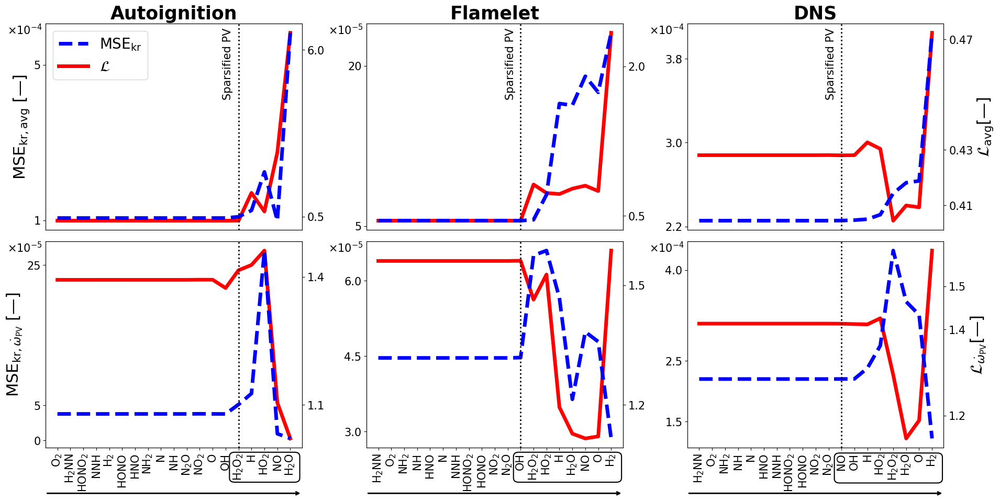

In [ ]:
save = False
clean = True
annotation = "with annotation"
pathSave = "C:/Users/admin/Documents/Parente/Figures/2024-PV-optimization/Paper/Results/Simplification of the PV/"
name = f"curves MSE kr bw 0.01 - manifold cost threshold PV with PVsource comb - all datasets - with log.pdf"

fig, ax = plt.subplots(2, 3, figsize=(19.2, 9.6), sharex=False)

################################
# AUTOIGNITION (col 0)
################################
# Top plot
ax1 = ax[0,0]
x_axis_species = np.arange(nbr_input_species, 0, -1)
latex_species_list = [s.replace('2', r'$_2$') for s in order_species_removed_0D]
latex_species_list = [s.replace('3', r'$_3$') for s in latex_species_list]

ax1.plot(x_axis_species, MSE_kr_bw_array_autoignition, 'b--', label="$\mathrm{MSE}_{\mathrm{kr}}$", linewidth=5)
ax1.set_ylabel('$\mathrm{MSE}_{\mathrm{kr, avg}}$ [\u2014]', fontsize=22)
ax1.tick_params(axis='y', labelsize=15)
if clean:
    ax1.tick_params(axis='x', labelsize=15)
ax1.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, pos: f'{int(x*1e4)}'))
ax1.annotate(r"$\times10^{-4}$", xy=(-0.15, 1), xycoords='axes fraction',
             fontsize=15, ha='left', va='top')

if annotation == "with annotation":
    ax1.annotate("Sparsified PV", xy=(0.69, 0.98), xycoords='axes fraction',
                 fontsize=15, rotation=90, ha='left', va='top')

ax1.set_yticks([0.0001, 0.0006])
ax1.set_xticks(range(1, len(latex_species_list) + 1))
ax1.set_xticklabels(latex_species_list[::-1], rotation=90)
if annotation == "with annotation":
    ax1.axvline(x=5, color='k', linestyle=':', linewidth=2)

if clean:
    ax1.tick_params(axis='x', bottom=False, labelbottom=False)

# Second y-axis
ax2 = ax1.twinx()
ax2.plot(x_axis_species, cost_array_pow4_autoignition, 'r-', label=r'$\mathcal{L}$', linewidth=5)
ax2.tick_params(axis='y', labelsize=15)
ax2.set_yticks([0.5, 6])
ax1.set_zorder(ax2.get_zorder() + 1)
ax1.patch.set_visible(False)

ax1.invert_xaxis()

# Legend only here
lines_1, labels_1 = ax1.get_legend_handles_labels()
lines_2, labels_2 = ax2.get_legend_handles_labels()
ax1.legend(lines_1 + lines_2, labels_1 + labels_2, loc='upper left', fontsize=20)

# Bottom plot
ax3 = ax[1,0]
latex_species_list = [s.replace('2', r'$_2$') for s in order_species_removed_0D]
latex_species_list = [s.replace('3', r'$_3$') for s in latex_species_list]
ax3.plot(x_axis_species, MSEPV_kr_bw_array_autoignition, 'b--', label="$\mathrm{MSE}_{NN}$", linewidth=5)
ax3.set_ylabel('$\mathrm{MSE}_{\mathrm{kr}, \dot{\omega}_{\mathrm{PV}}}$ [\u2014]', fontsize=22)
ax3.tick_params(axis='y', labelsize=15)
ax3.tick_params(axis='x', labelsize=15)
ax3.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, pos: f'{int(x*1e5)}'))
ax3.annotate(r"$\times10^{-5}$", xy=(-0.15, 1), xycoords='axes fraction',
             fontsize=15, ha='left', va='top')
ax3.set_yticks([0, 0.00005, 0.00025])
ax3.set_xticks(range(1, len(latex_species_list) + 1))
ax3.set_xticklabels(latex_species_list[::-1], rotation=90)

tick_positions = ax3.get_xticks()[17:]  # Select the first 8 ticks
tick_labels = ax3.get_xticklabels()[17:]

#box around the selected species for the simplified PV
fig = plt.gcf()
renderer = fig.canvas.get_renderer()

first_label_bbox = tick_labels[0].get_window_extent(renderer).transformed(ax3.transAxes.inverted())
last_label_bbox = tick_labels[-1].get_window_extent(renderer).transformed(ax3.transAxes.inverted())

# Define the rectangle covering only the x-ticks from 0 to 7
rect = patches.FancyBboxPatch(
    (first_label_bbox.x0-0.14, -1.2),  # X start position & Y just below tick labels
    last_label_bbox.x1 - first_label_bbox.x0 +0.13,  # Width to cover tick labels 0-7
    0.105,  # Height (just enough to wrap the tick labels)
    boxstyle="round,pad=0.02",
    edgecolor="black",
    facecolor="none",
    linewidth=1.5,
    transform=ax1.transAxes,
    clip_on=False  # Ensures the frame stays in the tick label area
)

if(annotation == "with annotation"):
    # Add rectangle to the figure
    ax3.add_patch(rect)

ax3.annotate(
        "",  # Empty text
        xy=(1, -0.22),  # Arrow end (right side, below x-axis)
        xycoords='axes fraction',
        xytext=(0, -0.22),  # Arrow start (left side, below x-axis)
        textcoords='axes fraction',
        arrowprops=dict(arrowstyle="->", linewidth=2, color="black")
    )

if annotation == "with annotation":
    ax3.axvline(x=5, color='k', linestyle=':', linewidth=2)
ax4 = ax3.twinx()
ax4.plot(x_axis_species, costPV_array_pow4_autoignition, 'r-', label=r'$\mathcal{L}_{\dot{\omega}_{\mathrm{PV}}}$', linewidth=5)
ax4.tick_params(axis='y', labelsize=15)
ax4.set_yticks([1.1, 1.4])
ax3.set_zorder(ax4.get_zorder() + 1)
ax3.patch.set_visible(False)
ax3.invert_xaxis()

################################
# FLAMELET (col 1)
################################
# Top plot
ax1 = ax[0,1]
x_axis_species = np.arange(nbr_input_species, 0, -1)
latex_species_list = [s.replace('2', r'$_2$') for s in order_species_removed_fl]
latex_species_list = [s.replace('3', r'$_3$') for s in latex_species_list]
ax1.plot(x_axis_species, MSE_kr_bw_array_flamelet, 'b--', linewidth=5)
ax1.tick_params(axis='y', labelsize=15)
if clean:
    ax1.tick_params(axis='x', labelsize=15)
ax1.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, pos: f'{int(x*1e5)}'))
ax1.annotate(r"$\times10^{-5}$", xy=(-0.15, 1), xycoords='axes fraction',
             fontsize=15, ha='left', va='top')
if annotation == "with annotation":
    ax1.annotate("Sparsified PV", xy=(0.54, 0.98), xycoords='axes fraction',
                 fontsize=15, rotation=90, ha='left', va='top')
ax1.set_yticks([0.00005, 0.0002])
ax1.set_xticks(range(1, len(latex_species_list) + 1))
ax1.set_xticklabels(latex_species_list[::-1], rotation=90)
if annotation == "with annotation":
    ax1.axvline(x=8, color='k', linestyle=':', linewidth=2)
if clean:
    ax1.tick_params(axis='x', bottom=False, labelbottom=False)
ax2 = ax1.twinx()
ax2.plot(x_axis_species, cost_array_pow4_flamelet, 'r-', linewidth=5)
ax2.tick_params(axis='y', labelsize=15)
ax2.set_yticks([0.5, 2])
ax1.set_zorder(ax2.get_zorder() + 1)
ax1.patch.set_visible(False)
ax1.invert_xaxis()

# Bottom plot
ax3 = ax[1,1]
ax3.plot(x_axis_species, MSEPV_kr_bw_array_flamelet, 'b--', linewidth=5)
ax3.tick_params(axis='y', labelsize=15)
ax3.tick_params(axis='x', labelsize=15)
ax3.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, pos: f'{np.round(x*1e5, 1)}'))
ax3.annotate(r"$\times10^{-5}$", xy=(-0.15, 1), xycoords='axes fraction',
             fontsize=15, ha='left', va='top')
ax3.set_yticks([0.00003, 0.000045, 0.00006])
ax3.set_xticks(range(1, len(latex_species_list) + 1))
ax3.set_xticklabels(latex_species_list[::-1], rotation=90)
if annotation == "with annotation":
    ax3.axvline(x=8, color='k', linestyle=':', linewidth=2)

tick_positions = ax3.get_xticks()[14:]  # Select the first 8 ticks
tick_labels = ax3.get_xticklabels()[14:]

#box around the selected species for the simplified PV
fig = plt.gcf()
renderer = fig.canvas.get_renderer()

first_label_bbox = tick_labels[0].get_window_extent(renderer).transformed(ax3.transAxes.inverted())
last_label_bbox = tick_labels[-1].get_window_extent(renderer).transformed(ax3.transAxes.inverted())

# Define the rectangle covering only the x-ticks from 0 to 7
rect = patches.FancyBboxPatch(
    (first_label_bbox.x0-0.1365, -1.2),  # X start position & Y just below tick labels
    last_label_bbox.x1 - first_label_bbox.x0 +0.13,  # Width to cover tick labels 0-7
    0.105,  # Height (just enough to wrap the tick labels)
    boxstyle="round,pad=0.02",
    edgecolor="black",
    facecolor="none",
    linewidth=1.5,
    transform=ax1.transAxes,
    clip_on=False  # Ensures the frame stays in the tick label area
)

if(annotation == "with annotation"):
    # Add rectangle to the figure
    ax3.add_patch(rect)

ax3.annotate(
        "",  # Empty text
        xy=(1, -0.22),  # Arrow end (right side, below x-axis)
        xycoords='axes fraction',
        xytext=(0, -0.22),  # Arrow start (left side, below x-axis)
        textcoords='axes fraction',
        arrowprops=dict(arrowstyle="->", linewidth=2, color="black")
    )

ax4 = ax3.twinx()
ax4.plot(x_axis_species, costPV_array_pow4_flamelet, 'r-', linewidth=5)
ax4.tick_params(axis='y', labelsize=15)
ax4.set_yticks([1.2, 1.5])
ax3.set_zorder(ax4.get_zorder() + 1)
ax3.patch.set_visible(False)
ax3.invert_xaxis()

################################
# DNS (col 2)
################################
# Top plot
ax1 = ax[0,2]
x_axis_species = np.arange(nbr_input_species, 0, -1)
latex_species_list = [s.replace('2', r'$_2$') for s in order_species_removed]
latex_species_list = [s.replace('3', r'$_3$') for s in latex_species_list]
ax1.plot(x_axis_species, MSE_kr_bw_array, 'b--', linewidth=5, zorder=2)
ax1.tick_params(axis='y', labelsize=15)
if clean:
    ax1.tick_params(axis='x', labelsize=15)
ax1.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, pos: f'{np.round(x*1e4,1)}'))
ax1.annotate(r"$\times10^{-4}$", xy=(-0.15, 1), xycoords='axes fraction',
             fontsize=15, ha='left', va='top')
if annotation == "with annotation":
    ax1.annotate("Sparsified PV", xy=(0.54, 0.98), xycoords='axes fraction',
                 fontsize=15, rotation=90, ha='left', va='top')
ax1.set_yticks([0.00022, 0.0003, 0.00038])
ax1.set_xticks(range(1, len(latex_species_list) + 1))
ax1.set_xticklabels(latex_species_list[::-1], rotation=90)
if annotation == "with annotation":
    ax1.axvline(x=8, color='k', linestyle=':', linewidth=2)
if clean:
    ax1.tick_params(axis='x', bottom=False, labelbottom=False)
ax2 = ax1.twinx()
ax2.plot(x_axis_species, cost_array_pow4, 'r-', linewidth=5, zorder=1)
ax2.set_ylabel(r'$\mathcal{L}_{\mathrm{avg}}$' + '[\u2014]', fontsize=22)
ax2.tick_params(axis='y', labelsize=15)
ax2.set_yticks([0.41, 0.43, 0.47])
ax1.set_zorder(ax2.get_zorder() + 1)
ax1.patch.set_visible(False)
ax1.invert_xaxis()

# Bottom plot
ax3 = ax[1,2]
ax3.plot(x_axis_species, MSEPV_kr_bw_array, 'b--', linewidth=5, zorder=2)
ax3.tick_params(axis='y', labelsize=15)
ax3.tick_params(axis='x', labelsize=15)
ax3.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, pos: f'{np.round(x*1e4, 1)}'))
ax3.annotate(r"$\times10^{-4}$", xy=(-0.15, 1), xycoords='axes fraction',
             fontsize=15, ha='left', va='top')

ax3.set_yticks([0.00015, 0.00025, 0.00040])
ax3.set_xticks(range(1, len(latex_species_list) + 1))
ax3.set_xticklabels(latex_species_list[::-1], rotation=90)
if annotation == "with annotation":
    ax3.axvline(x=8, color='k', linestyle=':', linewidth=2)

tick_positions = ax3.get_xticks()[14:]  # Select the first 8 ticks
tick_labels = ax3.get_xticklabels()[14:]

#box around the selected species for the simplified PV
fig = plt.gcf()
renderer = fig.canvas.get_renderer()

first_label_bbox = tick_labels[0].get_window_extent(renderer).transformed(ax3.transAxes.inverted())
last_label_bbox = tick_labels[-1].get_window_extent(renderer).transformed(ax3.transAxes.inverted())

# Define the rectangle covering only the x-ticks from 0 to 7
rect = patches.FancyBboxPatch(
    (first_label_bbox.x0 -0.1365 , -0.15),  # X start position & Y just below tick labels    0.1365    (first_label_bbox.x0-0.1365, -1.185)   + 0.585
    last_label_bbox.x1 - first_label_bbox.x0 + 0.13,  # Width to cover tick labels 0-7           +0.13    -0.65
    0.105,  # Height (just enough to wrap the tick labels)
    boxstyle="round,pad=0.02",
    edgecolor="black",
    facecolor="none",
    linewidth=1.5,
    transform=ax3.transAxes,
    clip_on=False  # Ensures the frame stays in the tick label area
)

if(annotation == "with annotation"):
    # Add rectangle to the figure
    ax3.add_patch(rect)

ax3.annotate(
        "",  # Empty text
        xy=(1, -0.22),  # Arrow end (right side, below x-axis)
        xycoords='axes fraction',
        xytext=(0, -0.22),  # Arrow start (left side, below x-axis)
        textcoords='axes fraction',
        arrowprops=dict(arrowstyle="->", linewidth=2, color="black")
    )

ax4 = ax3.twinx()
ax4.plot(x_axis_species, costPV_array_pow4, 'r-', linewidth=5, zorder=1)
ax4.set_ylabel(r'$\mathcal{L}_{\dot{\omega}_{\mathrm{PV}}}$' + '[\u2014]', fontsize=22)
ax4.tick_params(axis='y', labelsize=15)
ax4.set_yticks([1.2, 1.4, 1.5])
ax3.set_zorder(ax4.get_zorder() + 1)
ax3.patch.set_visible(False)
ax3.invert_xaxis()

ax[0, 0].set_title("Autoignition", fontsize=25, fontweight='bold')
ax[0, 1].set_title("Flamelet", fontsize=25, fontweight='bold')
ax[0, 2].set_title("DNS", fontsize=25, fontweight='bold')



################################
plt.tight_layout()
if(save):
    plt.savefig(pathSave + name, dpi=1000, bbox_inches = "tight")
plt.show()

## Kreg with constant bandwidth 0.001

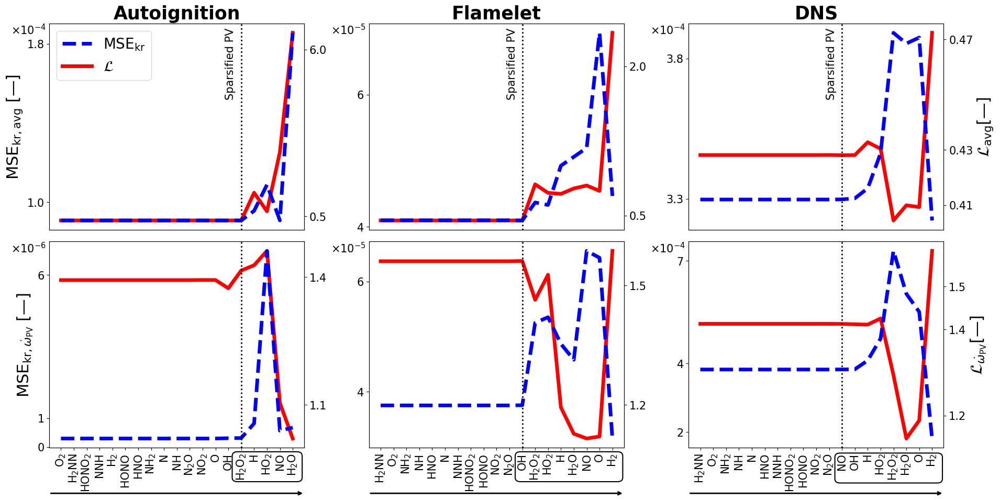

In [ ]:
save = True
clean = True
annotation = "with annotation"
pathSave = "C:/Users/admin/Documents/Parente/Figures/2024-PV-optimization/Paper/Results/Simplification of the PV/"
name = f"curves MSE kr bw 0.001 - manifold cost threshold PV with PVsource comb - all datasets - with log.pdf"

fig, ax = plt.subplots(2, 3, figsize=(19.2, 9.6), sharex=False)

################################
# AUTOIGNITION (col 0)
################################
# Top plot
ax1 = ax[0,0]
x_axis_species = np.arange(nbr_input_species, 0, -1)
latex_species_list = [s.replace('2', r'$_2$') for s in order_species_removed_0D]
latex_species_list = [s.replace('3', r'$_3$') for s in latex_species_list]

ax1.plot(x_axis_species, MSE_kr_bw0001_array_autoignition, 'b--', label="$\mathrm{MSE}_{\mathrm{kr}}$", linewidth=5)
ax1.set_ylabel('$\mathrm{MSE}_{\mathrm{kr, avg}}$ [\u2014]', fontsize=22)
ax1.tick_params(axis='y', labelsize=15)
if clean:
    ax1.tick_params(axis='x', labelsize=15)
ax1.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, pos: f'{np.round(x*1e4, 1)}'))
ax1.annotate(r"$\times10^{-4}$", xy=(-0.15, 1), xycoords='axes fraction',
             fontsize=15, ha='left', va='top')

if annotation == "with annotation":
    ax1.annotate("Sparsified PV", xy=(0.69, 0.98), xycoords='axes fraction',
                 fontsize=15, rotation=90, ha='left', va='top')

ax1.set_yticks([0.0001, 0.00018])

ax1.set_xticks(range(1, len(latex_species_list) + 1))
ax1.set_xticklabels(latex_species_list[::-1], rotation=90)
if annotation == "with annotation":
    ax1.axvline(x=5, color='k', linestyle=':', linewidth=2)

if clean:
    ax1.tick_params(axis='x', bottom=False, labelbottom=False)

# Second y-axis
ax2 = ax1.twinx()
ax2.plot(x_axis_species, cost_array_pow4_autoignition, 'r-', label=r'$\mathcal{L}$', linewidth=5)
ax2.tick_params(axis='y', labelsize=15)
ax2.set_yticks([0.5, 6])
ax1.set_zorder(ax2.get_zorder() + 1)
ax1.patch.set_visible(False)

ax1.invert_xaxis()

# Legend only here
lines_1, labels_1 = ax1.get_legend_handles_labels()
lines_2, labels_2 = ax2.get_legend_handles_labels()
ax1.legend(lines_1 + lines_2, labels_1 + labels_2, loc='upper left', fontsize=20)

# Bottom plot
ax3 = ax[1,0]
latex_species_list = [s.replace('2', r'$_2$') for s in order_species_removed_0D]
latex_species_list = [s.replace('3', r'$_3$') for s in latex_species_list]
ax3.plot(x_axis_species, MSEPV_kr_bw0001_array_autoignition, 'b--', label="$\mathrm{MSE}_{NN}$", linewidth=5)
ax3.set_ylabel('$\mathrm{MSE}_{\mathrm{kr}, \dot{\omega}_{\mathrm{PV}}}$ [\u2014]', fontsize=22)
ax3.tick_params(axis='y', labelsize=15)
ax3.tick_params(axis='x', labelsize=15)
ax3.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, pos: f'{int(x*1e6)}'))
ax3.annotate(r"$\times10^{-6}$", xy=(-0.15, 1), xycoords='axes fraction',
             fontsize=15, ha='left', va='top')
ax3.set_yticks([0, 0.000001, 0.000006])
ax3.set_xticks(range(1, len(latex_species_list) + 1))
ax3.set_xticklabels(latex_species_list[::-1], rotation=90)

tick_positions = ax3.get_xticks()[17:]  # Select the first 8 ticks
tick_labels = ax3.get_xticklabels()[17:]

#box around the selected species for the simplified PV
fig = plt.gcf()
renderer = fig.canvas.get_renderer()

first_label_bbox = tick_labels[0].get_window_extent(renderer).transformed(ax3.transAxes.inverted())
last_label_bbox = tick_labels[-1].get_window_extent(renderer).transformed(ax3.transAxes.inverted())

# Define the rectangle covering only the x-ticks from 0 to 7
rect = patches.FancyBboxPatch(
    (first_label_bbox.x0-0.14, -1.2),  # X start position & Y just below tick labels
    last_label_bbox.x1 - first_label_bbox.x0 +0.13,  # Width to cover tick labels 0-7
    0.105,  # Height (just enough to wrap the tick labels)
    boxstyle="round,pad=0.02",
    edgecolor="black",
    facecolor="none",
    linewidth=1.5,
    transform=ax1.transAxes,
    clip_on=False  # Ensures the frame stays in the tick label area
)

if(annotation == "with annotation"):
    # Add rectangle to the figure
    ax3.add_patch(rect)

ax3.annotate(
        "",  # Empty text
        xy=(1, -0.22),  # Arrow end (right side, below x-axis)
        xycoords='axes fraction',
        xytext=(0, -0.22),  # Arrow start (left side, below x-axis)
        textcoords='axes fraction',
        arrowprops=dict(arrowstyle="->", linewidth=2, color="black")
    )

if annotation == "with annotation":
    ax3.axvline(x=5, color='k', linestyle=':', linewidth=2)
ax4 = ax3.twinx()
ax4.plot(x_axis_species, costPV_array_pow4_autoignition, 'r-', label=r'$\mathcal{L}_{\dot{\omega}_{\mathrm{PV}}}$', linewidth=5)
ax4.tick_params(axis='y', labelsize=15)
ax4.set_yticks([1.1, 1.4])
ax3.set_zorder(ax4.get_zorder() + 1)
ax3.patch.set_visible(False)
ax3.invert_xaxis()

################################
# FLAMELET (col 1)
################################
# Top plot
ax1 = ax[0,1]
x_axis_species = np.arange(nbr_input_species, 0, -1)
latex_species_list = [s.replace('2', r'$_2$') for s in order_species_removed_fl]
latex_species_list = [s.replace('3', r'$_3$') for s in latex_species_list]
ax1.plot(x_axis_species, MSE_kr_bw0001_array_flamelet, 'b--', linewidth=5)
ax1.tick_params(axis='y', labelsize=15)
if clean:
    ax1.tick_params(axis='x', labelsize=15)
ax1.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, pos: f'{int(x*1e5)}'))
ax1.annotate(r"$\times10^{-5}$", xy=(-0.15, 1), xycoords='axes fraction',
             fontsize=15, ha='left', va='top')
if annotation == "with annotation":
    ax1.annotate("Sparsified PV", xy=(0.54, 0.98), xycoords='axes fraction',
                 fontsize=15, rotation=90, ha='left', va='top')
ax1.set_yticks([0.00004, 0.00006])
ax1.set_xticks(range(1, len(latex_species_list) + 1))
ax1.set_xticklabels(latex_species_list[::-1], rotation=90)
if annotation == "with annotation":
    ax1.axvline(x=8, color='k', linestyle=':', linewidth=2)
if clean:
    ax1.tick_params(axis='x', bottom=False, labelbottom=False)
ax2 = ax1.twinx()
ax2.plot(x_axis_species, cost_array_pow4_flamelet, 'r-', linewidth=5)
ax2.tick_params(axis='y', labelsize=15)
ax2.set_yticks([0.5, 2])
ax1.set_zorder(ax2.get_zorder() + 1)
ax1.patch.set_visible(False)
ax1.invert_xaxis()

# Bottom plot
ax3 = ax[1,1]
ax3.plot(x_axis_species, MSEPV_kr_bw0001_array_flamelet, 'b--', linewidth=5)
ax3.tick_params(axis='y', labelsize=15)
ax3.tick_params(axis='x', labelsize=15)
ax3.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, pos: f'{int(x*1e5)}'))
ax3.annotate(r"$\times10^{-5}$", xy=(-0.15, 1), xycoords='axes fraction',
             fontsize=15, ha='left', va='top')
ax3.set_yticks([0.00004, 0.00006])
ax3.set_xticks(range(1, len(latex_species_list) + 1))
ax3.set_xticklabels(latex_species_list[::-1], rotation=90)
if annotation == "with annotation":
    ax3.axvline(x=8, color='k', linestyle=':', linewidth=2)

tick_positions = ax3.get_xticks()[14:]  # Select the first 8 ticks
tick_labels = ax3.get_xticklabels()[14:]

#box around the selected species for the simplified PV
fig = plt.gcf()
renderer = fig.canvas.get_renderer()

first_label_bbox = tick_labels[0].get_window_extent(renderer).transformed(ax3.transAxes.inverted())
last_label_bbox = tick_labels[-1].get_window_extent(renderer).transformed(ax3.transAxes.inverted())

# Define the rectangle covering only the x-ticks from 0 to 7
rect = patches.FancyBboxPatch(
    (first_label_bbox.x0-0.1365, -1.2),  # X start position & Y just below tick labels
    last_label_bbox.x1 - first_label_bbox.x0 +0.13,  # Width to cover tick labels 0-7
    0.105,  # Height (just enough to wrap the tick labels)
    boxstyle="round,pad=0.02",
    edgecolor="black",
    facecolor="none",
    linewidth=1.5,
    transform=ax1.transAxes,
    clip_on=False  # Ensures the frame stays in the tick label area
)

if(annotation == "with annotation"):
    # Add rectangle to the figure
    ax3.add_patch(rect)

ax3.annotate(
        "",  # Empty text
        xy=(1, -0.22),  # Arrow end (right side, below x-axis)
        xycoords='axes fraction',
        xytext=(0, -0.22),  # Arrow start (left side, below x-axis)
        textcoords='axes fraction',
        arrowprops=dict(arrowstyle="->", linewidth=2, color="black")
    )

ax4 = ax3.twinx()
ax4.plot(x_axis_species, costPV_array_pow4_flamelet, 'r-', linewidth=5)
ax4.tick_params(axis='y', labelsize=15)
ax4.set_yticks([1.2, 1.5])
ax3.set_zorder(ax4.get_zorder() + 1)
ax3.patch.set_visible(False)
ax3.invert_xaxis()

################################
# DNS (col 2)
################################
# Top plot
ax1 = ax[0,2]
x_axis_species = np.arange(nbr_input_species, 0, -1)
latex_species_list = [s.replace('2', r'$_2$') for s in order_species_removed]
latex_species_list = [s.replace('3', r'$_3$') for s in latex_species_list]
ax1.plot(x_axis_species, MSE_kr_bw0001_array, 'b--', linewidth=5, zorder=2)
ax1.tick_params(axis='y', labelsize=15)
if clean:
    ax1.tick_params(axis='x', labelsize=15)
ax1.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, pos: f'{np.round(x*1e4,1)}'))
ax1.annotate(r"$\times10^{-4}$", xy=(-0.15, 1), xycoords='axes fraction',
             fontsize=15, ha='left', va='top')
if annotation == "with annotation":
    ax1.annotate("Sparsified PV", xy=(0.54, 0.98), xycoords='axes fraction',
                 fontsize=15, rotation=90, ha='left', va='top')
ax1.set_yticks([0.00033, 0.00038])
ax1.set_xticks(range(1, len(latex_species_list) + 1))
ax1.set_xticklabels(latex_species_list[::-1], rotation=90)
if annotation == "with annotation":
    ax1.axvline(x=8, color='k', linestyle=':', linewidth=2)
if clean:
    ax1.tick_params(axis='x', bottom=False, labelbottom=False)
ax2 = ax1.twinx()
ax2.plot(x_axis_species, cost_array_pow4, 'r-', linewidth=5, zorder=1)
ax2.set_ylabel(r'$\mathcal{L}_{\mathrm{avg}}$' + '[\u2014]', fontsize=22)
ax2.tick_params(axis='y', labelsize=15)
ax2.set_yticks([0.41, 0.43, 0.47])
ax1.set_zorder(ax2.get_zorder() + 1)
ax1.patch.set_visible(False)
ax1.invert_xaxis()

# Bottom plot
ax3 = ax[1,2]
ax3.plot(x_axis_species, MSEPV_kr_bw0001_array, 'b--', linewidth=5, zorder=2)
ax3.tick_params(axis='y', labelsize=15)
ax3.tick_params(axis='x', labelsize=15)
ax3.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, pos: f'{int(x*1e4)}'))
ax3.annotate(r"$\times10^{-4}$", xy=(-0.15, 1), xycoords='axes fraction',
             fontsize=15, ha='left', va='top')

ax3.set_yticks([0.0002, 0.0004, 0.0007])
ax3.set_xticks(range(1, len(latex_species_list) + 1))
ax3.set_xticklabels(latex_species_list[::-1], rotation=90)
if annotation == "with annotation":
    ax3.axvline(x=8, color='k', linestyle=':', linewidth=2)

tick_positions = ax3.get_xticks()[14:]  # Select the first 8 ticks
tick_labels = ax3.get_xticklabels()[14:]

#box around the selected species for the simplified PV
fig = plt.gcf()
renderer = fig.canvas.get_renderer()

first_label_bbox = tick_labels[0].get_window_extent(renderer).transformed(ax3.transAxes.inverted())
last_label_bbox = tick_labels[-1].get_window_extent(renderer).transformed(ax3.transAxes.inverted())

# Define the rectangle covering only the x-ticks from 0 to 7
rect = patches.FancyBboxPatch(
    (first_label_bbox.x0 -0.1365 , -0.15),  # X start position & Y just below tick labels    0.1365    (first_label_bbox.x0-0.1365, -1.185)   + 0.585
    last_label_bbox.x1 - first_label_bbox.x0 + 0.13,  # Width to cover tick labels 0-7           +0.13    -0.65
    0.105,  # Height (just enough to wrap the tick labels)
    boxstyle="round,pad=0.02",
    edgecolor="black",
    facecolor="none",
    linewidth=1.5,
    transform=ax3.transAxes,
    clip_on=False  # Ensures the frame stays in the tick label area
)

if(annotation == "with annotation"):
    # Add rectangle to the figure
    ax3.add_patch(rect)

ax3.annotate(
        "",  # Empty text
        xy=(1, -0.22),  # Arrow end (right side, below x-axis)
        xycoords='axes fraction',
        xytext=(0, -0.22),  # Arrow start (left side, below x-axis)
        textcoords='axes fraction',
        arrowprops=dict(arrowstyle="->", linewidth=2, color="black")
    )

ax4 = ax3.twinx()
ax4.plot(x_axis_species, costPV_array_pow4, 'r-', linewidth=5, zorder=1)
ax4.set_ylabel(r'$\mathcal{L}_{\dot{\omega}_{\mathrm{PV}}}$' + '[\u2014]', fontsize=22)
ax4.tick_params(axis='y', labelsize=15)
ax4.set_yticks([1.2, 1.4, 1.5])
ax3.set_zorder(ax4.get_zorder() + 1)
ax3.patch.set_visible(False)
ax3.invert_xaxis()

ax[0, 0].set_title("Autoignition", fontsize=25, fontweight='bold')
ax[0, 1].set_title("Flamelet", fontsize=25, fontweight='bold')
ax[0, 2].set_title("DNS", fontsize=25, fontweight='bold')



################################
plt.tight_layout()
if(save):
    plt.savefig(pathSave + name, dpi=1000, bbox_inches = "tight")
plt.show()

### With MSE NN values

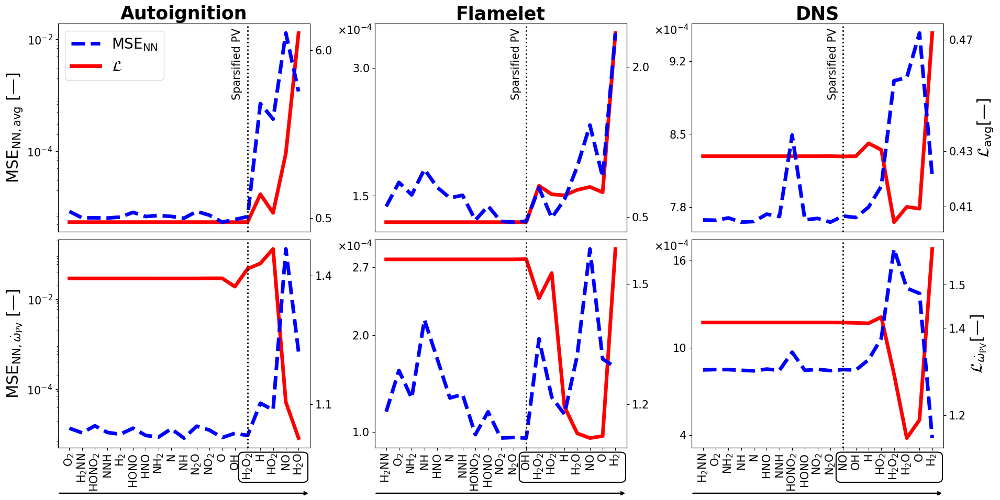

In [ ]:
save = True
pathSave = "C:/Users/admin/Documents/Parente/Figures/2024-PV-optimization/Paper/Results/Simplification of the PV/"
name = f"curves MSE NN - manifold cost threshold PV with PVsource comb - all datasets.pdf"

fig, ax = plt.subplots(2, 3, figsize=(19.2, 9.6), sharex=False)

################################
# AUTOIGNITION (col 0)
################################
# Top plot
ax1 = ax[0,0]
x_axis_species = np.arange(nbr_input_species, 0, -1)
latex_species_list = [s.replace('2', r'$_2$') for s in order_species_removed_0D]
latex_species_list = [s.replace('3', r'$_3$') for s in latex_species_list]

ax1.plot(x_axis_species, MSE_NN_array_autoignition, 'b--', label="$\mathrm{MSE}_{\mathrm{NN}}$", linewidth=5)
ax1.set_ylabel('$\mathrm{MSE}_{\mathrm{NN, avg}}$ [\u2014]', fontsize=22)
ax1.tick_params(axis='y', labelsize=15)
if clean:
    ax1.tick_params(axis='x', labelsize=15)

if annotation == "with annotation":
    ax1.annotate("Sparsified PV", xy=(0.69, 0.98), xycoords='axes fraction',
                 fontsize=15, rotation=90, ha='left', va='top')

ax1.set_yscale("log")
ax1.get_yaxis().set_minor_formatter(ticker.NullFormatter())
ax1.yaxis.set_major_locator(LogLocator(numticks=4))

ymin, ymax = ax1.get_ylim()
ax1.set_xticks(range(1, len(latex_species_list) + 1))
ax1.set_xticklabels(latex_species_list[::-1], rotation=90)
if annotation == "with annotation":
    ax1.axvline(x=5, color='k', linestyle=':', linewidth=2)

if clean:
    ax1.tick_params(axis='x', bottom=False, labelbottom=False)

# Second y-axis
ax2 = ax1.twinx()
ax2.plot(x_axis_species, cost_array_pow4_autoignition, 'r-', label=r'$\mathcal{L}$', linewidth=5)
ax2.tick_params(axis='y', labelsize=15)
ax2.set_yticks([0.5, 6])
ax1.set_zorder(ax2.get_zorder() + 1)
ax1.patch.set_visible(False)

ax1.invert_xaxis()

# Legend only here
lines_1, labels_1 = ax1.get_legend_handles_labels()
lines_2, labels_2 = ax2.get_legend_handles_labels()
ax1.legend(lines_1 + lines_2, labels_1 + labels_2, loc='upper left', fontsize=20)

# Bottom plot
ax3 = ax[1,0]
latex_species_list = [s.replace('2', r'$_2$') for s in order_species_removed_0D]
latex_species_list = [s.replace('3', r'$_3$') for s in latex_species_list]
ax3.plot(x_axis_species, MSE_NN_PV_array_autoignition, 'b--', label="$\mathrm{MSE}_{NN}$", linewidth=5)
ax3.set_ylabel('$\mathrm{MSE}_{\mathrm{NN}, \dot{\omega}_{\mathrm{PV}}}$ [\u2014]', fontsize=22)
ax3.tick_params(axis='y', labelsize=15)
ax3.tick_params(axis='x', labelsize=15)
ax3.set_yscale("log")
ax3.get_yaxis().set_minor_formatter(ticker.NullFormatter())
ax3.yaxis.set_major_locator(LogLocator(numticks=4))

ax3.set_xticks(range(1, len(latex_species_list) + 1))
ax3.set_xticklabels(latex_species_list[::-1], rotation=90)

tick_positions = ax3.get_xticks()[17:]  # Select the first 8 ticks
tick_labels = ax3.get_xticklabels()[17:]

#box around the selected species for the simplified PV
fig = plt.gcf()
renderer = fig.canvas.get_renderer()

first_label_bbox = tick_labels[0].get_window_extent(renderer).transformed(ax3.transAxes.inverted())
last_label_bbox = tick_labels[-1].get_window_extent(renderer).transformed(ax3.transAxes.inverted())

# Define the rectangle covering only the x-ticks from 0 to 7
rect = patches.FancyBboxPatch(
    (first_label_bbox.x0-0.14, -1.185),  # X start position & Y just below tick labels
    last_label_bbox.x1 - first_label_bbox.x0 +0.13,  # Width to cover tick labels 0-7
    0.105,  # Height (just enough to wrap the tick labels)
    boxstyle="round,pad=0.02",
    edgecolor="black",
    facecolor="none",
    linewidth=1.5,
    transform=ax1.transAxes,
    clip_on=False  # Ensures the frame stays in the tick label area
)

if(annotation == "with annotation"):
    # Add rectangle to the figure
    ax3.add_patch(rect)

ax3.annotate(
        "",  # Empty text
        xy=(1, -0.22),  # Arrow end (right side, below x-axis)
        xycoords='axes fraction',
        xytext=(0, -0.22),  # Arrow start (left side, below x-axis)
        textcoords='axes fraction',
        arrowprops=dict(arrowstyle="->", linewidth=2, color="black")
    )

if annotation == "with annotation":
    ax3.axvline(x=5, color='k', linestyle=':', linewidth=2)
ax4 = ax3.twinx()
ax4.plot(x_axis_species, costPV_array_pow4_autoignition, 'r-', label=r'$\mathcal{L}_{\dot{\omega}_{\mathrm{PV}}}$', linewidth=5)
ax4.tick_params(axis='y', labelsize=15)
ax4.set_yticks([1.1, 1.4])
ax3.set_zorder(ax4.get_zorder() + 1)
ax3.patch.set_visible(False)
ax3.invert_xaxis()

################################
# FLAMELET (col 1)
################################
# Top plot
ax1 = ax[0,1]
x_axis_species = np.arange(nbr_input_species, 0, -1)
latex_species_list = [s.replace('2', r'$_2$') for s in order_species_removed_fl]
latex_species_list = [s.replace('3', r'$_3$') for s in latex_species_list]
ax1.plot(x_axis_species, MSE_NN_array_flamelet, 'b--', linewidth=5)
ax1.tick_params(axis='y', labelsize=15)
if clean:
    ax1.tick_params(axis='x', labelsize=15)
ax1.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, pos: f'{np.round(x*1e4,1)}'))
ax1.annotate(r"$\times10^{-4}$", xy=(-0.15, 1), xycoords='axes fraction',
             fontsize=15, ha='left', va='top')
if annotation == "with annotation":
    ax1.annotate("Sparsified PV", xy=(0.54, 0.98), xycoords='axes fraction',
                 fontsize=15, rotation=90, ha='left', va='top')
ax1.set_yticks([0.00015, 0.0003])
ax1.set_xticks(range(1, len(latex_species_list) + 1))
ax1.set_xticklabels(latex_species_list[::-1], rotation=90)
if annotation == "with annotation":
    ax1.axvline(x=8, color='k', linestyle=':', linewidth=2)
if clean:
    ax1.tick_params(axis='x', bottom=False, labelbottom=False)
ax2 = ax1.twinx()
ax2.plot(x_axis_species, cost_array_pow4_flamelet, 'r-', linewidth=5)
ax2.tick_params(axis='y', labelsize=15)
ax2.set_yticks([0.5, 2])
ax1.set_zorder(ax2.get_zorder() + 1)
ax1.patch.set_visible(False)
ax1.invert_xaxis()

# Bottom plot
ax3 = ax[1,1]
ax3.plot(x_axis_species, MSE_NN_PV_array_flamelet, 'b--', linewidth=5)
ax3.tick_params(axis='y', labelsize=15)
ax3.tick_params(axis='x', labelsize=15)
ax3.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, pos: f'{np.round(x*1e4, 1)}'))
ax3.annotate(r"$\times10^{-4}$", xy=(-0.15, 1), xycoords='axes fraction',
             fontsize=15, ha='left', va='top')
ax3.set_yticks([0.0001, 0.0002, 0.00027])
ax3.set_xticks(range(1, len(latex_species_list) + 1))
ax3.set_xticklabels(latex_species_list[::-1], rotation=90)
if annotation == "with annotation":
    ax3.axvline(x=8, color='k', linestyle=':', linewidth=2)

tick_positions = ax3.get_xticks()[14:]  # Select the first 8 ticks
tick_labels = ax3.get_xticklabels()[14:]

#box around the selected species for the simplified PV
fig = plt.gcf()
renderer = fig.canvas.get_renderer()

first_label_bbox = tick_labels[0].get_window_extent(renderer).transformed(ax3.transAxes.inverted())
last_label_bbox = tick_labels[-1].get_window_extent(renderer).transformed(ax3.transAxes.inverted())

# Define the rectangle covering only the x-ticks from 0 to 7
rect = patches.FancyBboxPatch(
    (first_label_bbox.x0-0.1365, -1.185),  # X start position & Y just below tick labels
    last_label_bbox.x1 - first_label_bbox.x0 +0.13,  # Width to cover tick labels 0-7
    0.105,  # Height (just enough to wrap the tick labels)
    boxstyle="round,pad=0.02",
    edgecolor="black",
    facecolor="none",
    linewidth=1.5,
    transform=ax1.transAxes,
    clip_on=False  # Ensures the frame stays in the tick label area
)

if(annotation == "with annotation"):
    # Add rectangle to the figure
    ax3.add_patch(rect)

ax3.annotate(
        "",  # Empty text
        xy=(1, -0.22),  # Arrow end (right side, below x-axis)
        xycoords='axes fraction',
        xytext=(0, -0.22),  # Arrow start (left side, below x-axis)
        textcoords='axes fraction',
        arrowprops=dict(arrowstyle="->", linewidth=2, color="black")
    )

ax4 = ax3.twinx()
ax4.plot(x_axis_species, costPV_array_pow4_flamelet, 'r-', linewidth=5)
#ax4.set_ylabel(r'$\mathcal{L}_{\dot{\omega}_{\mathrm{PV}}}$' + '[\u2014]', fontsize=20)
ax4.tick_params(axis='y', labelsize=15)
ax4.set_yticks([1.2, 1.5])
ax3.set_zorder(ax4.get_zorder() + 1)
ax3.patch.set_visible(False)
ax3.invert_xaxis()

################################
# DNS (col 2)
################################
# Top plot
ax1 = ax[0,2]
x_axis_species = np.arange(nbr_input_species, 0, -1)
latex_species_list = [s.replace('2', r'$_2$') for s in order_species_removed]
latex_species_list = [s.replace('3', r'$_3$') for s in latex_species_list]
ax1.plot(x_axis_species, MSE_NN_array, 'b--', linewidth=5, zorder=2)
ax1.tick_params(axis='y', labelsize=15)
if clean:
    ax1.tick_params(axis='x', labelsize=15)
ax1.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, pos: f'{np.round(x*1e4,1)}'))
ax1.annotate(r"$\times10^{-4}$", xy=(-0.15, 1), xycoords='axes fraction',
             fontsize=15, ha='left', va='top')
if annotation == "with annotation":
    ax1.annotate("Sparsified PV", xy=(0.54, 0.98), xycoords='axes fraction',
                 fontsize=15, rotation=90, ha='left', va='top')
ax1.set_yticks([0.00078, 0.00085, 0.00092])
ax1.set_xticks(range(1, len(latex_species_list) + 1))
ax1.set_xticklabels(latex_species_list[::-1], rotation=90)
if annotation == "with annotation":
    ax1.axvline(x=8, color='k', linestyle=':', linewidth=2)
if clean:
    ax1.tick_params(axis='x', bottom=False, labelbottom=False)
ax2 = ax1.twinx()
ax2.plot(x_axis_species, cost_array_pow4, 'r-', linewidth=5, zorder=1)
ax2.set_ylabel(r'$\mathcal{L}_{\mathrm{avg}}$' + '[\u2014]', fontsize=22)
ax2.tick_params(axis='y', labelsize=15)
ax2.set_yticks([0.41, 0.43, 0.47])
ax1.set_zorder(ax2.get_zorder() + 1)
ax1.patch.set_visible(False)
ax1.invert_xaxis()

# Bottom plot
ax3 = ax[1,2]
ax3.plot(x_axis_species, MSE_NN_PV_array, 'b--', linewidth=5, zorder=2)
ax3.tick_params(axis='y', labelsize=15)
ax3.tick_params(axis='x', labelsize=15)
ax3.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, pos: f'{int(x*1e4)}'))
ax3.annotate(r"$\times10^{-4}$", xy=(-0.15, 1), xycoords='axes fraction',
             fontsize=15, ha='left', va='top')
ax3.set_yticks([0.0004, 0.001, 0.0016])
ax3.set_xticks(range(1, len(latex_species_list) + 1))
ax3.set_xticklabels(latex_species_list[::-1], rotation=90)
if annotation == "with annotation":
    ax3.axvline(x=8, color='k', linestyle=':', linewidth=2)

tick_positions = ax3.get_xticks()[14:]  # Select the first 8 ticks
tick_labels = ax3.get_xticklabels()[14:]

#box around the selected species for the simplified PV
fig = plt.gcf()
renderer = fig.canvas.get_renderer()

first_label_bbox = tick_labels[0].get_window_extent(renderer).transformed(ax3.transAxes.inverted())
last_label_bbox = tick_labels[-1].get_window_extent(renderer).transformed(ax3.transAxes.inverted())

# Define the rectangle covering only the x-ticks from 0 to 7
rect = patches.FancyBboxPatch(
    (first_label_bbox.x0-0.1365, -1.185),  # X start position & Y just below tick labels
    last_label_bbox.x1 - first_label_bbox.x0 +0.13,  # Width to cover tick labels 0-7
    0.105,  # Height (just enough to wrap the tick labels)
    boxstyle="round,pad=0.02",
    edgecolor="black",
    facecolor="none",
    linewidth=1.5,
    transform=ax1.transAxes,
    clip_on=False  # Ensures the frame stays in the tick label area
)

if(annotation == "with annotation"):
    # Add rectangle to the figure
    ax3.add_patch(rect)

ax3.annotate(
        "",  # Empty text
        xy=(1, -0.22),  # Arrow end (right side, below x-axis)
        xycoords='axes fraction',
        xytext=(0, -0.22),  # Arrow start (left side, below x-axis)
        textcoords='axes fraction',
        arrowprops=dict(arrowstyle="->", linewidth=2, color="black")
    )

ax4 = ax3.twinx()
ax4.plot(x_axis_species, costPV_array_pow4, 'r-', linewidth=5, zorder=1)
ax4.set_ylabel(r'$\mathcal{L}_{\dot{\omega}_{\mathrm{PV}}}$' + '[\u2014]', fontsize=22)
ax4.tick_params(axis='y', labelsize=15)
ax4.set_yticks([1.2, 1.4, 1.5])
ax3.set_zorder(ax4.get_zorder() + 1)
ax3.patch.set_visible(False)
ax3.invert_xaxis()

ax[0, 0].set_title("Autoignition", fontsize=25, fontweight='bold')
ax[0, 1].set_title("Flamelet", fontsize=25, fontweight='bold')
ax[0, 2].set_title("DNS", fontsize=25, fontweight='bold')



################################
plt.tight_layout()
if(save):
    plt.savefig(pathSave + name, dpi=1000)
plt.show()